<a href="https://colab.research.google.com/github/Murcha1990/ML_AI24/blob/main/Hometasks/Pro/AI_HW1_Regression_with_inference_pro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Домашнее задание №1 (pro)**

В этом домашнем задании вам будет необходимо:
*  обучить модель регрессии для предсказания стоимости автомобилей;
* реализовать веб-сервис для применения построенной модели на новых данных

> Оценка за домашку = $min(\text{ваш балл}, 11)$

**Мягкий дедлайн: 27 ноября 23:59**

**Жесткий дедлайн: 20 декабря 23:59 (конец модуля)**



**Примечание**

В каждой части оцениваются как код, **так и ответы на вопросы.** Вопросы подсвечены синим цветом.

Если нет одного и/или другого, то часть баллов за соответствующее задание снимается.

In [1]:
import pickle
import re
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import seaborn as sns

random.seed(42)
np.random.seed(42)

### **Задание 0**
Для чего фиксируем сиды в домашках?

Для обеспечения воспроизводимости результатов.

# **Часть 1 | EDA**


Первая часть состоит из классических шагов EDA:

- Базовый EDA и обработка признаков (1.7 балла)
- Визуализации признаков и их анализ (1.6 балл)

Всего можно набрать 3.3 основных балла и 0.25 бонусных.

В следующих частях, вы увидите бонусные задания. Бонусные задания выделены как **Дополнительное задание/Бонус**. Вы можете выполнять их, чтобы в случае ошибок в основных задачах всё равно набрать за работу максимум. Кроме того, дополнительные задания позволяют вам углубить знания.

Призываем активно использовать их!

## **Простейший EDA и обработка признаков (1.7 балла)**

In [7]:
df_train = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_train.csv')
df_test = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_test.csv')

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

Train data shape: (6999, 13)
Test data shape:  (1000, 13)


### **Задание 1.(0.4 балла)**
Выполните операции, направленные на базовое исследование данных:

- [ ] Посмотрите, есть ли в датасете пропуски и дубликаты. Запишите/выведите названия колонок, для которых есть пропущенные значения (0.1 балла)
- [ ] Посмотрите, есть ли в данных явные дубликаты (0.05 балла)
- [ ] Постройте дашборд в одну строку, используя [ydata-profilling](https://github.com/ydataai/ydata-profiling)(0.15 балла)
- [ ] Опишите базовые выводы (какие — выберите сами), используя дашборд (0.2 балла)

In [9]:
df_train.isna().sum()[df_train.isna().sum() > 0]

mileage      202
engine       202
max_power    196
torque       203
seats        202
dtype: int64

In [10]:
df_test.isna().sum()[df_test.isna().sum() > 0]

mileage      19
engine       19
max_power    19
torque       19
seats        19
dtype: int64

In [14]:
df_train.duplicated().sum()

985

In [16]:
df_test.duplicated().sum()

62

In [19]:
!pip install ydata-profiling
#!pip install ipywidgets

In [21]:
from ydata_profiling import ProfileReport

In [22]:
ProfileReport(df_train, title="Train").to_widgets()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [24]:
ProfileReport(df_test, title="Test").to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



- В тестовых данных наблюдается 0.7% пропусков и 3.3% полных дубликатов строк в то время как в тренировочных данных наблюдается 1.1% пропусков и 7% полных дубликатов строк
- Среди всех переменных `selling_price` наиболее коррелирован с  переменными `transmission` и `year`
- Исходя из графика Cloud of Words по переменной `name` можно сказать, что наиболее часто встречающимся брендом автомобилей в выборке является Maruti
- Как в тестовых, так и в тренировочных данных наиболее часто встречаются машины с механической коробкой передач.
- Переменные `max_power` и `torque` являются числовыми, а не категориальными. Просто нужно немного поработать с переменными, чтобы преобразовать их
- Можно сделать и другие базовые выводы.


### **Задание 2 (0.2 балла)**
Проанализируйте статистики датасета.

**Ваша задача:**
- [ ] Посчитайте основные статистики по числовым столбцам для трейна и теста
- [ ] Посчитайте основные статистики по категориальным столбцам для трейна и теста
- [ ] Сравните среднее и медиану внутри `train`, внутри `test` и между собой. О чём могут говорить результаты?

**Подсказка:**

Используте ``.describe()`` с нужным(и) аргументом(-ами).

In [18]:
pd.options.display.float_format = '{:.3f}'.format

In [20]:
df_train.describe()

,year,selling_price,km_driven,seats
count,6999.000,6999.000,6999.000,6797.000
mean,2013.818,639515.197,69584.616,5.419
std,4.053,808941.912,57724.002,0.966
min,1983.000,29999.000,1.000,2.000
25%,2011.000,254999.000,35000.000,5.000
50%,2015.000,450000.000,60000.000,5.000
75%,2017.000,675000.000,97000.000,5.000
max,2020.000,10000000.000,2360457.000,14.000


In [22]:
df_test.describe()

,year,selling_price,km_driven,seats
count,1000.000,1000.000,1000.000,981.000
mean,2013.681,617901.042,71393.341,5.411
std,4.012,758553.861,48486.219,0.920
min,1995.000,31000.000,1303.000,4.000
25%,2011.000,250000.000,37000.000,5.000
50%,2014.000,434999.000,61500.000,5.000
75%,2017.000,670000.000,100000.000,5.000
max,2020.000,6000000.000,375000.000,9.000


В данных тренировочных и тестовых данных наблюдается схожее распределение признаков, однако есть отличия. В обоих датасетах для переменной `selling_price` среднее значительно превышает медиану. Это указывает на наличие выбросов с высокими ценами на автомобили, которые особенно выраженны в `df_train`. Переменная `km_driven` также имеет среднее, которое превышает медиану, что может говорить о наличии выбросов с большими значениями пробега, но распределение более равномерное. Переменная `seats` имеет близкие средние и медианные значения в обоих датасетах, что указывает на его однородное распределение. При сравнении между `df_train` и `df_test` видно, что цены и пробеги в среднем выше в `df_train`, что может быть связано с тем, что в тренировочных данных больше наблюдений с дорогими автомобилями.

In [25]:
df_train.describe(include='object')

,name,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque
count,6999,6999,6999,6999,6999,6797,6797,6803,6796
unique,1924,4,3,2,5,386,120,316,419
top,Maruti Swift Dzire VDI,Diesel,Individual,Manual,First Owner,18.9 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm
freq,116,3793,5826,6095,4587,197,885,330,468


In [27]:
df_test.describe(include='object')

,name,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque
count,1000,1000,1000,1000,1000,981,981,981,981
unique,621,4,3,2,5,237,88,182,226
top,Maruti Alto 800 LXI,Diesel,Individual,Manual,First Owner,18.6 kmpl,1248 CC,74 bhp,200Nm@ 1750rpm
freq,15,534,837,877,623,23,116,43,57


### **Задание 3 (0.2 балла)**

- [ ] Посмотрите, есть ли в трейне объекты с одинаковым признаковым описанием (целевую переменную следует исключить). Если есть, то сколько? (0.05 балла)
- [ ] Отобразите такие объекты (0.05 балла)
- [ ] Удалите повторяющиеся строки. Если при одинаковом признаковом описании цены на автомобили отличаются, то оставьте первую строку по этому автомобилю (0.05 балла)
- [ ]  Обновите индексы строк таким образом, чтобы они шли от 0 без пропусков (0.05 балла)

In [30]:
# your code here
df_train.drop(columns=['selling_price']).duplicated().sum()

1159

In [32]:
df_train[df_train.drop(columns=['selling_price']).duplicated()].head()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
254,Hyundai Grand i10 Sportz,2017,450000,35000,Petrol,Individual,Manual,First Owner,18.9 kmpl,1197 CC,82 bhp,114Nm@ 4000rpm,5.000
258,Maruti Swift VXI,2012,330000,50000,Petrol,Individual,Manual,Second Owner,18.6 kmpl,1197 CC,85.8 bhp,114Nm@ 4000rpm,5.000
268,Maruti Swift Dzire VXI,2014,400000,70000,Petrol,Individual,Manual,Second Owner,19.1 kmpl,1197 CC,85.8 bhp,114Nm@ 4000rpm,5.000
324,Jaguar XE 2016-2019 2.0L Diesel Prestige,2017,2625000,9000,Diesel,Dealer,Automatic,First Owner,13.6 kmpl,1999 CC,177 bhp,430Nm@ 1750-2500rpm,5.000
325,Lexus ES 300h,2019,5150000,20000,Petrol,Dealer,Automatic,First Owner,22.37 kmpl,2487 CC,214.56 bhp,202Nm@ 3600-5200rpm,5.000


In [34]:
df_train = df_train[~(df_train.drop(columns=['selling_price']).duplicated())].reset_index(drop=True)

In [36]:
assert df_train.shape == (5840, 13)

### **Задание 4 (0.3 балла)**

Вы могли заметить, что с признаками ``mileage, engine, max_power и torque`` всё не очень хорошо. Они распознаются как строки (можно убедиться в этом, вызвав `data.dtypes`). Однако эти переменные не являются категориальными — они — числа. Соответственно, нужно привести их к числовому виду.

**Задача :**
* [ ] Уберите единицы измерения для признаков ``mileage, engine, max_power``.
* [ ] Приведите тип данных к ``float``.
* [ ] Предобработайте признак `torque` — разделите его на два: собственно `torque` и `max_torque_rpm`. Учтите единицы измерения


**Важно**
- Все действия нужно производить над обоими датасетами — `train` и `test`.

In [39]:
df_train.dtypes

name              object
year               int64
selling_price      int64
km_driven          int64
fuel              object
seller_type       object
transmission      object
owner             object
mileage           object
engine            object
max_power         object
torque            object
seats            float64
dtype: object

In [41]:
def df_processing_1(data):
    data['mileage'] = data.mileage.fillna('0').apply(lambda x: x.strip(' kmpl').strip(' km/kg')).astype(float).replace(0, np.nan)
    data['engine'] = data.engine.fillna('0').apply(lambda x: x.strip(' CC')).astype(float).replace(0, np.nan)
    data['max_power'] = data.max_power.fillna('0').apply(lambda x: x.strip(' bhp')).replace('', '0').astype(float).replace(0, np.nan)
    torque = []
    max_torque_rpm = []
    series = data.torque.fillna('0').apply(lambda x: x.replace(',', '')).apply(str.lower)
    for i in np.arange(len(data)):
        numbers = re.findall(r'\d+\.?\d*', series[i])
        if 'kgm' in series[i]:
            torque.append(float(numbers[0]) * 9.8)
        elif 'nm' in series[i]:
            torque.append(float(numbers[0]))
        else:
            torque.append(np.nan)

        if len(numbers) >= 2:
            max_torque_rpm.append(float(numbers[-1]))
        else:
            max_torque_rpm.append(np.nan)

    data['torque_new'] = torque
    data['max_torque_rpm'] = max_torque_rpm

    return data

In [43]:
df_test = df_processing_1(df_test)

In [45]:
df_test.describe()

,year,selling_price,km_driven,mileage,engine,max_power,seats,torque_new,max_torque_rpm
count,1000.000,1000.000,1000.000,980.000,981.000,981.000,981.000,980.000,977.000
mean,2013.681,617901.042,71393.341,19.358,1458.883,91.016,5.411,178.019,3090.866
std,4.012,758553.861,48486.219,3.944,526.229,35.207,0.920,104.714,897.948
min,1995.000,31000.000,1303.000,9.500,624.000,34.200,4.000,48.000,500.000
25%,2011.000,250000.000,37000.000,16.500,1197.000,69.000,5.000,110.000,2500.000
50%,2014.000,434999.000,61500.000,19.330,1248.000,83.100,5.000,171.800,3000.000
75%,2017.000,670000.000,100000.000,22.320,1582.000,102.000,5.000,213.000,4000.000
max,2020.000,6000000.000,375000.000,32.260,3604.000,280.000,9.000,1421.000,5200.000


In [47]:
df_test[df_test.torque_new > 700]

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_new,max_torque_rpm
108,Maruti SX4 Vxi BSIII,2009,250000,125876,Petrol,Individual,Manual,Second Owner,15.000,1586.000,104.680,"145@ 4,100(kgm@ rpm)",5.000,1421.000,4100.000
413,Ford Ikon 1.6 Really Sport,2003,130000,80000,Petrol,Individual,Manual,Third Owner,14.200,1597.000,92.000,130@ 2500(kgm@ rpm),5.000,1274.000,2500.000


In [49]:
df_test.loc[df_test.torque_new > 700, 'torque_new'] = df_test.loc[df_test.torque_new > 700, 'torque_new'] / 9.8

In [51]:
df_train = df_processing_1(df_train)

In [53]:
df_train.describe()

,year,selling_price,km_driven,mileage,engine,max_power,seats,torque_new,max_torque_rpm
count,5840.000,5840.000,5840.000,5640.000,5654.000,5653.000,5654.000,5644.000,5650.000
mean,2013.428,522960.091,73952.242,19.481,1435.418,88.150,5.441,176.333,3041.311
std,4.096,535432.002,60071.137,3.938,492.453,32.076,0.995,118.594,931.579
min,1983.000,29999.000,1.000,9.000,624.000,32.800,2.000,47.040,500.000
25%,2011.000,250000.000,39000.000,16.800,1197.000,68.000,5.000,111.700,2250.000
50%,2014.000,405000.000,70000.000,19.400,1248.000,81.860,5.000,160.000,3000.000
75%,2017.000,640000.000,100000.000,22.320,1498.000,100.000,5.000,200.000,4000.000
max,2020.000,10000000.000,2360457.000,42.000,3604.000,400.000,14.000,3724.000,21800.000


In [55]:
df_train[df_train.torque_new > 700]

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_new,max_torque_rpm
498,Tata Sumo CX 10 Str BSIV,2011,175000,20000,Diesel,Individual,Manual,First Owner,12.200,1948.000,68.000,"115@ 2,500(kgm@ rpm)",10.000,1127.000,2500.000
633,Ford Endeavour Hurricane Limited Edition,2013,1075000,110000,Diesel,Individual,Automatic,Third Owner,12.800,2953.000,156.000,380Nm(38.7kgm)@ 2500rpm,7.000,3724.000,2500.000
770,Maruti Zen D,2003,85000,120000,Diesel,Individual,Manual,Third Owner,20.800,1527.000,58.000,789Nm@ 2250rpm,5.000,789.000,2250.000
920,Maruti SX4 Vxi BSIII,2007,160000,120000,Petrol,Individual,Manual,Second Owner,15.000,1586.000,104.680,"145@ 4,100(kgm@ rpm)",5.000,1421.000,4100.000
1616,Tata Sumo EX 10/7 Str BSIII,2012,200000,67500,Diesel,Individual,Manual,First Owner,12.200,1948.000,68.000,"115@ 2,500(kgm@ rpm)",10.000,1127.000,2500.000
1787,Maruti SX4 Zxi BSIII,2010,300000,22000,Petrol,Individual,Manual,First Owner,15.000,1586.000,104.680,"145@ 4,100(kgm@ rpm)",5.000,1421.000,4100.000
1809,Maruti SX4 Zxi with Leather BSIII,2008,150000,89000,Petrol,Individual,Manual,Second Owner,15.600,1586.000,104.680,"145@ 4,100(kgm@ rpm)",5.000,1421.000,4100.000
1898,Ford Ikon 1.6 Nxt,2009,180000,70000,Petrol,Individual,Manual,Second Owner,14.200,1597.000,92.000,130@ 2500(kgm@ rpm),5.000,1274.000,2500.000
2242,Ford Ikon 1.6 EXi NXt,2003,150000,40000,Petrol,Individual,Manual,Third Owner,14.200,1597.000,92.000,130@ 2500(kgm@ rpm),5.000,1274.000,2500.000
3115,Maruti SX4 Vxi BSIII,2009,150000,110000,Petrol,Individual,Manual,First Owner,15.000,1586.000,104.680,"145@ 4,100(kgm@ rpm)",5.000,1421.000,4100.000


In [57]:
df_train.loc[df_train.torque_new > 800, 'torque_new'] = df_train.loc[df_train.torque_new > 800, 'torque_new'] / 9.8
df_train.loc[df_train.torque_new > 700, 'torque_new'] = df_train.loc[df_train.torque_new > 700, 'torque_new'] / 10
df_train.loc[df_train.max_torque_rpm == 21800, 'max_torque_rpm'] = df_train.loc[df_train.max_torque_rpm == 21800, 'max_torque_rpm'] / 10

In [59]:
df_train.describe()

,year,selling_price,km_driven,mileage,engine,max_power,seats,torque_new,max_torque_rpm
count,5840.000,5840.000,5840.000,5640.000,5654.000,5653.000,5654.000,5644.000,5650.000
mean,2013.428,522960.091,73952.242,19.481,1435.418,88.150,5.441,171.356,3037.839
std,4.096,535432.002,60071.137,3.938,492.453,32.076,0.995,84.080,897.590
min,1983.000,29999.000,1.000,9.000,624.000,32.800,2.000,47.040,500.000
25%,2011.000,250000.000,39000.000,16.800,1197.000,68.000,5.000,111.700,2250.000
50%,2014.000,405000.000,70000.000,19.400,1248.000,81.860,5.000,160.000,3000.000
75%,2017.000,640000.000,100000.000,22.320,1498.000,100.000,5.000,200.000,4000.000
max,2020.000,10000000.000,2360457.000,42.000,3604.000,400.000,14.000,640.000,5300.000


In [61]:
df_train = df_train.drop(columns=['torque']).rename(columns={'torque_new':'torque'})
df_test = df_test.drop(columns=['torque']).rename(columns={'torque_new':'torque'})

In [63]:
df_train.head()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque,max_torque_rpm
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.400,1248.000,74.000,5.000,190.000,2000.000
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.140,1498.000,103.520,5.000,250.000,2500.000
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.000,1396.000,90.000,5.000,219.520,2750.000
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.100,1298.000,88.200,5.000,112.700,4500.000
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.140,1197.000,81.860,5.000,113.750,4000.000


### **Задание 5 (0.3 балла)**

На первом шаге мы обнаружили пропуски. Давайте избавимся от них.

**Задание:**
- [ ] Заполните пропуски в столбцах медианами. Убедитесь, что после заполнения пропусков не осталось.
- [ ] Почему стоит применять именно медиану. Могли ли мы применить среднее? Обоснуйте свое рассуждение.
- [ ] Как правильно считать медиану для заполнения? Выберите верное утверждение:
 - По тестовым свою, по тренировочным — свою
 - По тренировочным данным для `train` и `test`






- При заполнении пропусков стоит использовать медиану, так как она является устойчивой к выбросам, в то время как среднее значение сильно искажается при наличии выбросов.

- Стоит заполнять пропуски по тренировочным данным для `test` и `train`

In [67]:
# your code here
df_train.isna().sum()[df_train.isna().sum() > 0]

mileage           200
engine            186
max_power         187
seats             186
torque            196
max_torque_rpm    190
dtype: int64

In [69]:
df_train[df_train.mileage.isna()]

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque,max_torque_rpm
12,Maruti Swift 1.3 VXi,2007,200000,80000,Petrol,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN,NaN
28,Fiat Palio 1.2 ELX,2003,70000,50000,Petrol,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN,NaN
69,Tata Indica DLS,2003,50000,70000,Diesel,Individual,Manual,First Owner,NaN,NaN,NaN,NaN,NaN,NaN
78,Maruti Swift VDI BSIV W ABS,2015,475000,78000,Diesel,Dealer,Manual,First Owner,NaN,NaN,NaN,NaN,NaN,NaN
107,Maruti Swift VDI BSIV,2010,300000,120000,Diesel,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5602,Hyundai Santro Xing XG,2004,70000,70000,Petrol,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN,NaN
5737,Hyundai Santro LS zipPlus,2000,140000,50000,Petrol,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN,NaN
5748,Hyundai Santro Xing XS eRLX Euro III,2006,145000,80000,Petrol,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN,NaN
5794,Ford Figo Aspire Facelift,2017,580000,165000,Diesel,Individual,Manual,First Owner,NaN,NaN,NaN,NaN,NaN,NaN


In [71]:
condition = df_train.mileage.isna()

In [73]:
na_cols = ['mileage', 'engine', 'max_power', 'seats', 'torque', 'max_torque_rpm']
medians = df_train[na_cols].median()
df_train[na_cols] = df_train[na_cols].fillna(medians)
df_test[na_cols] = df_test[na_cols].fillna(medians)

### **Задание 6 (0.2 балла)**

Теперь, когда не осталось пропусков, давайте преобразуем столбцы к более подходящим типам. А именно столбцы ``engnine`` и ``seats`` к приведем к `int`.

- [ ] Осуществите приведение столбцов к необходимому типу.
- [ ] Ответье на вопрос — почему (хоть мы этого и не делаем) ``seats``, возможно рассмотреть как категориальную переменную?

In [76]:
# your code here
df_train = df_train.astype({'engine': int, 'seats': int})
df_test = df_test.astype({'engine': int, 'seats': int})
df_train.dtypes

name               object
year                int64
selling_price       int64
km_driven           int64
fuel               object
seller_type        object
transmission       object
owner              object
mileage           float64
engine              int64
max_power         float64
seats               int64
torque            float64
max_torque_rpm    float64
dtype: object

Переменную `seats` стоило бы рассмотреть как категориальную переменную, так как она скорее отражает разные типы автомобилей. Например купе или минивен.

### **Задание 7 (0.1 балла)**

Снова вызовите метод describe и проанализируйте статистики.

**Ответье на вопрос:**
- [ ] Есть ли основания предполагать, что заполнение пропусков свдинуло наши распределения? Могло ли это вообще возникнуть?

In [80]:
df_train.describe()

,year,selling_price,km_driven,mileage,engine,max_power,seats,torque,max_torque_rpm
count,5840.000,5840.000,5840.000,5840.000,5840.000,5840.000,5840.000,5840.000,5840.000
mean,2013.428,522960.091,73952.242,19.478,1429.449,87.948,5.427,170.974,3036.608
std,4.096,535432.002,60071.137,3.870,485.663,31.578,0.982,82.682,882.891
min,1983.000,29999.000,1.000,9.000,624.000,32.800,2.000,47.040,500.000
25%,2011.000,250000.000,39000.000,17.000,1197.000,68.000,5.000,111.800,2250.000
50%,2014.000,405000.000,70000.000,19.400,1248.000,81.860,5.000,160.000,3000.000
75%,2017.000,640000.000,100000.000,22.300,1498.000,99.000,5.000,200.000,4000.000
max,2020.000,10000000.000,2360457.000,42.000,3604.000,400.000,14.000,640.000,5300.000


In [82]:
df_test.describe()

,year,selling_price,km_driven,mileage,engine,max_power,seats,torque,max_torque_rpm
count,1000.000,1000.000,1000.000,1000.000,1000.000,1000.000,1000.000,1000.000,1000.000
mean,2013.681,617901.042,71393.341,19.359,1454.876,90.842,5.403,175.239,3088.776
std,4.012,758553.861,48486.219,3.904,521.996,34.893,0.913,89.436,887.656
min,1995.000,31000.000,1303.000,9.500,624.000,34.200,4.000,48.000,500.000
25%,2011.000,250000.000,37000.000,16.550,1197.000,69.000,5.000,111.700,2500.000
50%,2014.000,434999.000,61500.000,19.400,1248.000,82.425,5.000,160.000,3000.000
75%,2017.000,670000.000,100000.000,22.300,1582.000,102.000,5.000,205.000,4000.000
max,2020.000,6000000.000,375000.000,32.260,3604.000,280.000,9.000,620.000,5200.000


Так как пропуски заполнялись медианными значениями, то распределение хоть и изменилось, но оно изменилось минимально.

## **Визуализации и корреляция (1.6 балла + 0.25)**

Визуализация данных — важный шаг в работе. Визуализировать данные необходимо, например, чтобы:

- Оценить распределения признаков самих по себе (это может натоклнуть вас на мысли о модели, которую можно использовать)
- Сравнить распределения на `train` и `test` — чтобы проверить, насколько информация, на которой вы будете обучаться согласуется с той, на которой модель должна работать
- Оценить есть ли явная связь признаков с целевой переменной

**Важно:**

Если распределения на `train` и `test` не совпадают, это не значит, что нужно перемешивать данные! Более корректно актуализировать задачу и уточнить, а не устарели ли данные `train`. Также полезным может быть собрать новую тестовую выборку, смешав те, что имеются сейчас.

**Если вы будете подгонять распределения, то можете встретиться с переобучением!**

### **Задание 8 (0.5 балла)**

Шаг 1.
- [ ] Воспользуйтесь `pairplot` из библиотеки `seabron`, чтобы визуализировать попарные распределения числовых признаков для `train`
- [ ] По полученному графику ответьте на вопросы:
 - Можно ли предположить на основе распределений связь признаков с целевой переменной?
 - Можно ли предположить на основе распределений выдвинуть гипотезу о корреляциях признаков?

Шаг 2.

- [ ] Постройте pairplot по тестовым данным
- [ ] Ответьте на вопрос "Похожими ли оказались совокупности при разделении на трейн и тест?"

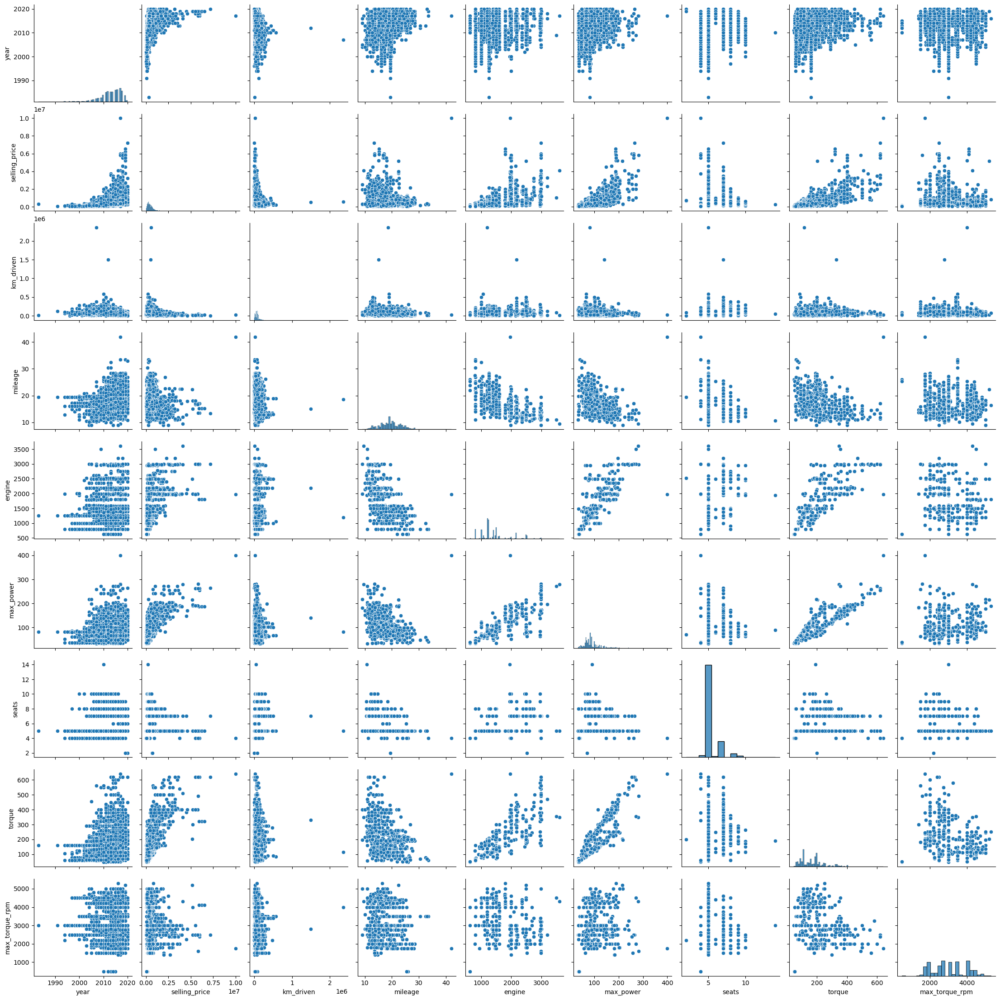

In [88]:
%matplotlib inline
# your code here
sns.pairplot(df_train)
plt.show()

#### Cвязь признаков с целевой переменной
На диаграммах рассеяния видно, что некоторые признаки имеют нелинейную связь с переменной `selling_price`:
- `year`- чем новее год выпуска, тем выше цена. Распределение указывает на обратную зависимость между возрастом автомобиля и его стоимостью.
- `km_driven`- переменная имеет слабую отрицательную связь с ценой. Большой пробег в целом соответствует более низкой цене.
- `max_power` и `engine` - для этих переменных наблюдается положительная связь — автомобили с большей мощностью двигателя или объёмом двигателя имеют более высокую цену.
- `mileage` -  корреляция слабая, но автомобили с низким расходом топлива имеют тенденцию к более высокой цене.

#### Гипотезы о корреляции между переменными

- Переменные `engine` и `max_power` имеют линейную положительную связь, так как больший объем двигателя, как правило, связан с большей мощностью
- `torque` и `max_power` также имеют положительную корреляцию, так как обе переменные свзязаны с характеристиками произовдительности

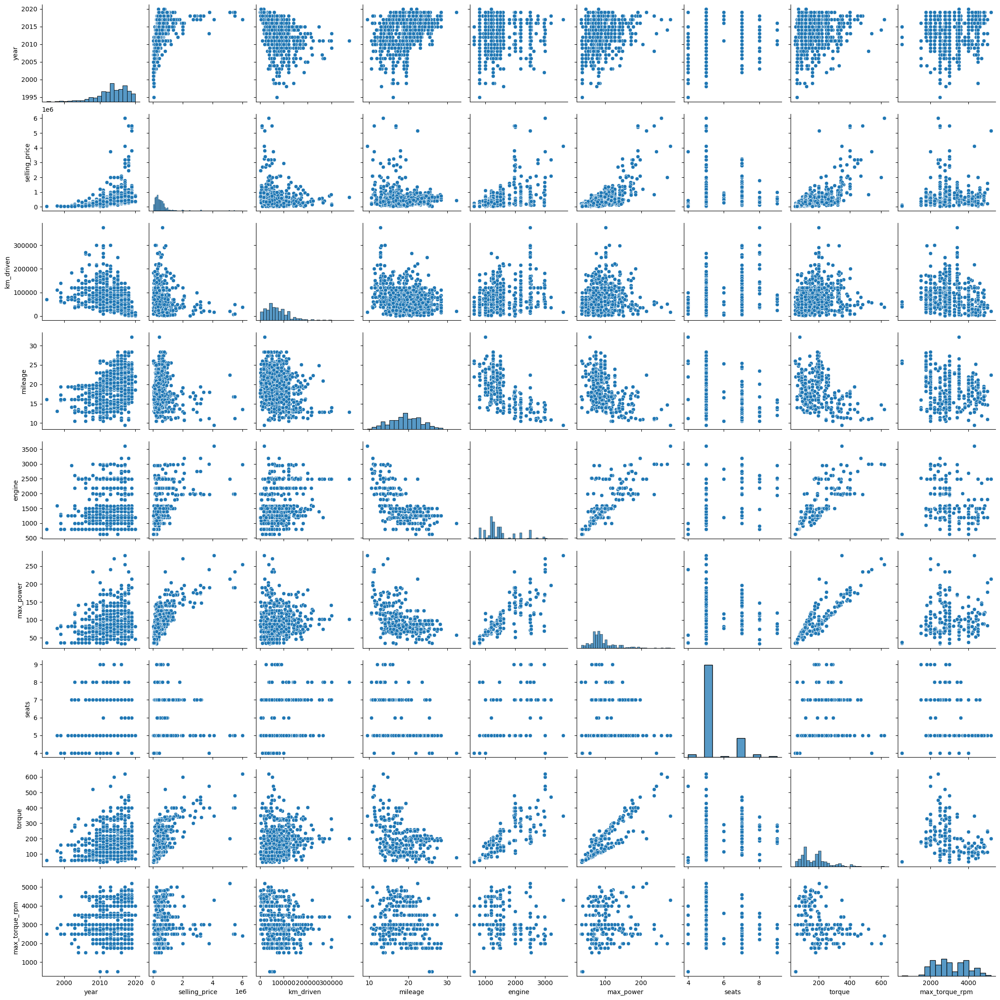

In [90]:
sns.pairplot(df_test)
plt.show()

Если судить по графикам, то тренировочная и тестовая выборки достаточно похожи, как по распределениям, так и корреляциям между признаками.

### **Задание 9 (0.5 балла)**

И так, вы выдвинули гипотезы о наличии связи. Теперь давайте оценим эту связь в числах.

**Задание:**
- [ ] Получите значения коэффициента корреляции Пирсона для тренировочного набора данных при помощи `pd.corr()`
- [ ] По полученным корреляциям постройте тепловую карту (`heatmap` из бибилотеки seaborn)

In [93]:
# your code here
df_train.select_dtypes(include=['number']).corr()

,year,selling_price,km_driven,mileage,engine,max_power,seats,torque,max_torque_rpm
year,1.000,0.427,-0.369,0.349,0.003,0.157,0.041,0.144,0.059
selling_price,0.427,1.000,-0.165,-0.103,0.448,0.694,0.150,0.637,-0.083
km_driven,-0.369,-0.165,1.000,-0.191,0.230,0.025,0.192,0.132,-0.214
mileage,0.349,-0.103,-0.191,1.000,-0.586,-0.385,-0.475,-0.252,-0.197
engine,0.003,0.448,0.230,-0.586,1.000,0.682,0.652,0.749,-0.246
max_power,0.157,0.694,0.025,-0.385,0.682,1.000,0.244,0.853,-0.010
seats,0.041,0.150,0.192,-0.475,0.652,0.244,1.000,0.381,-0.209
torque,0.144,0.637,0.132,-0.252,0.749,0.853,0.381,1.000,-0.436
max_torque_rpm,0.059,-0.083,-0.214,-0.197,-0.246,-0.010,-0.209,-0.436,1.000


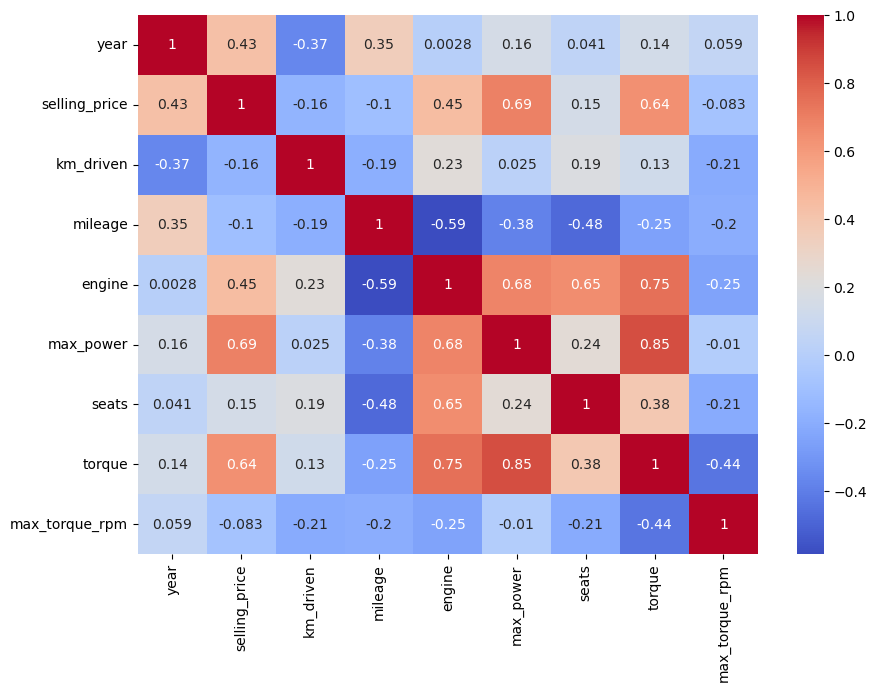

In [94]:
plt.figure(figsize=(10,7))
sns.heatmap(df_train.select_dtypes(include=['number']).corr(), annot=True, cmap='coolwarm')
plt.show()

- [ ] Ответьте на вопросы:
 - Какие 2 признака наименее скоррелированы между собой?
 - Между какими наблюдается довольно сильная положительная линейная зависимость?
 - Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи?

- Наименее коррелированы между собой признаки `year` - `engine` (0.0028) и `max_power` - `max_torque_rpm` (-0.01)
- Довольно сильная линейная зависимость наблюдается между `max_power` - `torque` (0.85), `engine` - `torque` (0.75) и `max_power` - `engine` (0.68)
- Да, это утверждение верно. Корреляция между `year` и `km_driven` равна -0.37, что указывает на умеренную отрицательную зависимость: чем старше автомобиль, тем больше он, как правило, проехал.

### **Задание 10 (0.6 балла)**

По умолчанию `pd.corr` возвращает корреляцию Пирсона, говорящую о линейной взаимосвязи. Но зависимости существуют не только линейные! В этой задаче, попробуйте измерить другие способы вычисления корреляций.

- [ ] Реализуйте корреляцию Спирмена/Кендала (на выбор) без использования библиотек (можно пользоваться только `numpy`). Сравните результаты вычисления с библиотечной реализацией
- [ ]

Постройте матрицу корреляции [phik](https://pypi.org/project/phik/)
- [ ] Проинтерпретируйте результаты


In [98]:
def s_corr(data):
    ranked_data = np.argsort(np.argsort(data, axis=0), axis=0)
    ranked_centered = ranked_data - np.mean(ranked_data, axis=0)
    covariance_matrix = np.dot(ranked_centered.T, ranked_centered) / (ranked_data.shape[0] - 1)
    std_devs = np.sqrt(np.diag(covariance_matrix))
    correlation_matrix = covariance_matrix / np.outer(std_devs, std_devs)
    return correlation_matrix

In [99]:
pd.DataFrame(s_corr(df_train.select_dtypes(include=['number'])))

,0,1,2,3,4,5,6,7,8
0,1.000,0.705,-0.566,0.342,-0.035,0.167,0.050,0.122,0.077
1,0.705,1.000,-0.296,0.026,0.462,0.612,0.221,0.597,-0.118
2,-0.566,-0.296,1.000,-0.200,0.303,0.040,0.105,0.235,-0.315
3,0.342,0.026,-0.200,1.000,-0.431,-0.311,-0.310,-0.147,-0.183
4,-0.035,0.462,0.303,-0.431,1.000,0.712,0.362,0.831,-0.362
5,0.167,0.612,0.040,-0.311,0.712,1.000,0.201,0.782,-0.016
6,0.050,0.221,0.105,-0.310,0.362,0.201,1.000,0.286,-0.123
7,0.122,0.597,0.235,-0.147,0.831,0.782,0.286,1.000,-0.523
8,0.077,-0.118,-0.315,-0.183,-0.362,-0.016,-0.123,-0.523,1.000


In [100]:
df_train.select_dtypes(include=['number']).corr(method='spearman')

,year,selling_price,km_driven,mileage,engine,max_power,seats,torque,max_torque_rpm
year,1.000,0.707,-0.570,0.346,-0.038,0.166,0.048,0.121,0.079
selling_price,0.707,1.000,-0.296,0.026,0.464,0.612,0.318,0.597,-0.119
km_driven,-0.570,-0.296,1.000,-0.200,0.305,0.041,0.195,0.236,-0.317
mileage,0.346,0.026,-0.200,1.000,-0.432,-0.311,-0.440,-0.147,-0.184
engine,-0.038,0.464,0.305,-0.432,1.000,0.714,0.528,0.834,-0.365
max_power,0.166,0.612,0.041,-0.311,0.714,1.000,0.305,0.783,-0.017
seats,0.048,0.318,0.195,-0.440,0.528,0.305,1.000,0.434,-0.191
torque,0.121,0.597,0.236,-0.147,0.834,0.783,0.434,1.000,-0.526
max_torque_rpm,0.079,-0.119,-0.317,-0.184,-0.365,-0.017,-0.191,-0.526,1.000


interval columns not set, guessing: ['year', 'selling_price', 'km_driven', 'mileage', 'engine', 'max_power', 'seats', 'torque', 'max_torque_rpm']


/opt/anaconda3/lib/python3.12/site-packages/phik/data_quality.py:59: UserWarning: The number of unique values of variable name is large: 1924. Are you sure this is not an interval variable? Analysis for pairs of variables including name can be slow.
  warnings.warn(


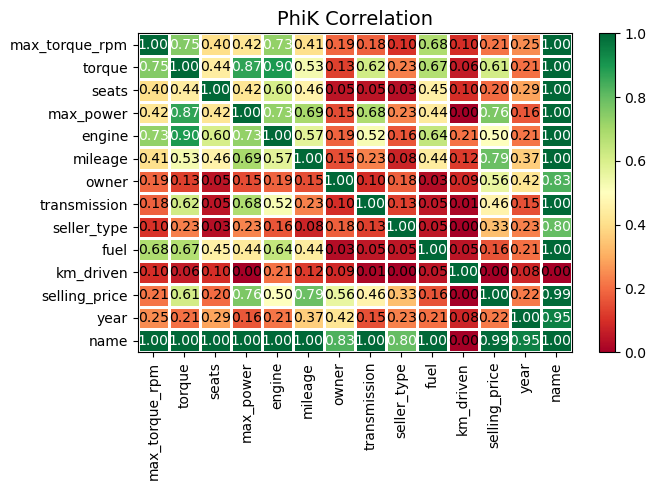

In [101]:
from phik import resources
from phik.report import plot_correlation_matrix
from phik import phik_matrix


# Вычисление PhiK матрицы
phik_matrix = df_train.phik_matrix()

# Построение тепловой карты
plot_correlation_matrix(phik_matrix.values, x_labels=phik_matrix.columns, y_labels=phik_matrix.index, vmin=0, vmax=1, title="PhiK Correlation")

На тепловой корреляции PhiK видно, что некоторые признаки демонстрируют сильные зависимости. Самую высокую корреляцию с целевой переменной `selling_price` имеют переменные `engine` (0.79), `max_power` (0.76), и `torque` (0.61), что подтверждает их значимость для предсказания цены, так как они связаны с производительностью автомобиля. Слабая корреляция наблюдается у переменных `year` (0.22) и `km_driven` (0.16), что указывает на менее прямое влияние возраста и пробега на цену. Признаки, такие как `fuel`, `seller_type`, и `owner`, имеют низкую корреляцию с целевой переменной, что может говорить о менее существенном их влиянии. Между техническими характеристиками `engine`, `max_power`, `torque` наблюдается высокая взаимосвязь (более 0.7), что указывает на возможную мультиколлинеарность. В целом, технические параметры играют ключевую роль в ценообразовании, тогда как категории `seller_type`, `transmission`, `fuel` оказывают более косвенное влияние.

### **Дополнительные визуализации (бонус 0.2 балла)**

Если вам кажется, что мы не попросили вас нарисовать какие-то очень важные зависимости, нарисуйте их и поясните.

In [104]:
# your code here
df_train['car_brand'] = df_train.name.apply(lambda x: x.strip()).apply(str.split).apply(lambda x: x[0])

In [105]:
df_test['car_brand'] = df_test.name.apply(lambda x: x.strip()).apply(str.split).apply(lambda x: x[0])

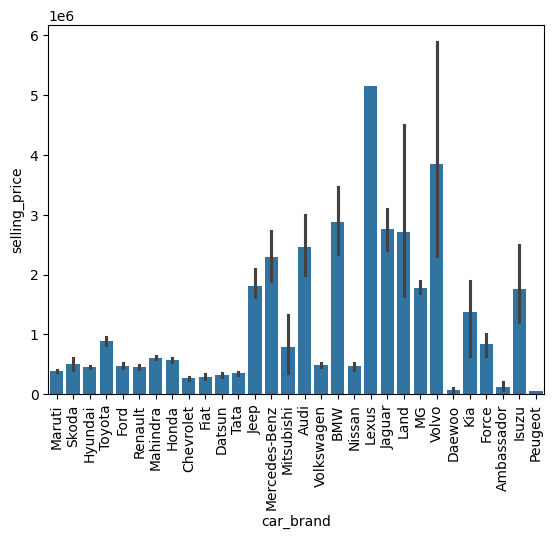

In [106]:
sns.barplot(data = df_train, x = 'car_brand', y = 'selling_price')
plt.xticks(rotation=90)
plt.show()

График показывает, что средняя цена продажи `selling_price` автомобилей значительно варьируется в зависимости от бренда. Премиальные бренды, такие как Mercedes-Benz, BMW, Jaguar, и Lexus, имеют самые высокие средние цены и широкий диапазон значений, что отражает разнообразие моделей от базовых до люксовых. Массовые бренды, такие как Maruti, Hyundai, и Ford, демонстрируют более низкие средние цены и узкий разброс, ориентируясь на бюджетный сегмент. Менее популярные бренды, такие как Force или Peugeot, имеют ограниченную выборку с низкими ценами и широкими доверительными интервалами. Это подчеркивает значительное влияние бренда на стоимость автомобиля.

# **Часть 2 (1.7 балла) | Модель только на вещественных признаках**

В этой части вам предстоит обучить модель только на вещественных признаках. Почему только на них?

Чем больше признаковое пространство — чем сложнее модель. А чем модель проще — тем лучше для скорости работы и интерпретации признаков.

За задания этой части вы можете набрать 1.7 основных и 0.15 бонусных балла;

### **Задание 11 (0.05 балла)**

Разбейте данные на тренировочный и тестовый наборы. Перед разбиением создайте копию датафрейма, который будет хранить только вещественные признаки и используйте его (то есть категориальные столбцы (все, кроме seats) необходимо удалить).

В переменные y_train и y_test запишите значения целевых переменных.

In [111]:
y_train = df_train['selling_price']
X_train = df_train.select_dtypes(include=['number']).drop(columns = ['selling_price',])

In [112]:
X_train

,year,km_driven,mileage,engine,max_power,seats,torque,max_torque_rpm
0,2014,145500,23.400,1248,74.000,5,190.000,2000.000
1,2014,120000,21.140,1498,103.520,5,250.000,2500.000
2,2010,127000,23.000,1396,90.000,5,219.520,2750.000
3,2007,120000,16.100,1298,88.200,5,112.700,4500.000
4,2017,45000,20.140,1197,81.860,5,113.750,4000.000
...,...,...,...,...,...,...,...,...
5835,2008,191000,17.920,1086,62.100,5,96.100,3000.000
5836,2013,50000,18.900,998,67.100,5,90.000,3500.000
5837,2013,110000,18.500,1197,82.850,5,113.700,4000.000
5838,2007,119000,16.800,1493,110.000,5,235.200,2750.000


In [113]:
#assert X_train.shape == (5840, 6)

In [114]:
y_test = df_test['selling_price']
X_test = df_test.select_dtypes(include=['number']).drop(columns = ['selling_price',])

In [115]:
X_test

,year,km_driven,mileage,engine,max_power,seats,torque,max_torque_rpm
0,2010,168000,14.000,2498,112.000,7,260.000,2200.000
1,2017,25000,21.500,1497,108.500,5,260.000,2750.000
2,2007,218463,12.900,1799,130.000,5,172.000,4300.000
3,2015,173000,25.100,1498,98.600,5,200.000,1750.000
4,2011,70000,16.500,1172,65.000,5,96.000,3000.000
...,...,...,...,...,...,...,...,...
995,2008,100000,19.810,1086,68.050,5,99.040,4500.000
996,2017,50000,18.600,1197,81.830,5,114.700,4000.000
997,2009,40000,23.000,1396,90.000,5,219.520,2750.000
998,2012,25000,20.360,1197,78.900,5,111.800,4000.000


In [116]:
#assert X_test.shape == (1000, 6)

### **Задание 12. (0.2 балла)**

Построим нашу первую модель!
- [ ] Обучите классическую линейную регрессию с дефолтными параметрами. Посчтитайте $R^2$ и $MSE$ для трейна и для теста.
- [ ] Сделайте выводы по значениям метрик качества.

**Примечание:**

Здесь и далее $R^2$ и $MSE$ для трейна и для теста выводите везде, где требуется обучать модели, даже если в явном виде этого не просят. Иначе непонятно, как понять, насколько успешны наши эксперименты.

In [118]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error as MSE

model1 = LinearRegression()
model1.fit(X_train, y_train)

y_pred_train_m1 = model1.predict(X_train)
y_pred_test_m1 = model1.predict(X_test)

mse1 = MSE(y_train, y_pred_train_m1)
mse2 = MSE(y_test, y_pred_test_m1)
r2_1 = r2_score(y_train, y_pred_train_m1)
r2_2 = r2_score(y_test, y_pred_test_m1)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

Метрики регрессии:
MSE Train: 113618132536.329
MSE Test: 229376851375.343
R² Train: 0.604
R² Test: 0.601


In [119]:
with open('models/m1_lr_num.pkl', 'wb') as f:
    pickle.dump(model1, f)

Метрики линейной регрессии показывают, что модель объясняет около 60% вариации целевой переменной `selling_price`, с R^2 для `train` и `test` равным 0.604 и 0.601 соответственно, что свидетельствует о стабильности и отсутствии переобучения. Однако высокие значения MSE указывают на значительные ошибки предсказания, вероятно, из-за выбросов и нелинейных зависимостей, которые линейная регрессия не может учесть. Также модель может показывать не самые высокие метрики, так как были неучтены категориальные переменные.

### **Задание 13 (0.15 балла)**

- [ ] Реализуйте $R^2$ руками. Приведите формулу $R^2$ и объясните каждую компоненту метрики

In [122]:
def r2_m(y_true, y_pred):
  # RSS = Σ(y_true - y_pred)^2  # Остаточная сумма квадратов
    RSS = np.sum((y_true - y_pred) ** 2)
  # TSS = Σ(y_true - mean(y_true))^2  # Общая сумма квадратов
    TSS = np.sum((y_true - np.mean(y_true)) ** 2)
  # R^2 = 1 - (RSS / TSS)
    r2 = 1 - (RSS / TSS)
    # R^2 принимает значения от 0 до 1:
    # - R^2 = 1: модель идеально объясняет данные.
    # - R^2 < 1: модель объясняет только часть вариации, остальная остаётся необъясненной.
    return r2

### **Бонус (0.15 балла)**

- [ ] Реализуйте [$\text{adjusted}-R^2$](https://en.wikipedia.org/wiki/Coefficient_of_determination).
- [ ] Объясните, когда применяется $\text{adjusted}-R^2$?

In [131]:
# your code here
def r2a_m(y_true, y_pred, n, p):
    r2 = r2_m(y_true, y_pred)
    adj_r2 = 1 - ((1 - r2) * (n - 1) / (n - p - 1))
    return adj_r2

 Такой вариант метрики используется для оценки качества модели, учитывая количество признаков, чтобы избежать ложного повышения  при добавлении нерелевантных признаков.

### **Задание 14 (0.05 балла)**

Всегда есть место совершенству. Поэтому давайте попробуем улучшить модель. При помощи стандартизации признаков.

- [ ] Стандартизируйте значения в тренировочных и тестовых данных. Стандартизатор **обучайте только на `train`**.

In [134]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_s = scaler.fit_transform(X_train)
X_test_s = scaler.transform(X_test)

model2 = LinearRegression()
model2.fit(X_train_s, y_train)

y_pred_train_m2 = model2.predict(X_train_s)
y_pred_test_m2 = model2.predict(X_test_s)

mse1 = MSE(y_train, y_pred_train_m2 )
mse2 = MSE(y_test, y_pred_test_m2 )
r2_1 = r2_score(y_train, y_pred_train_m2)
r2_2 = r2_score(y_test, y_pred_test_m2)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

# your code here

Метрики регрессии:
MSE Train: 113618132536.329
MSE Test: 229376851375.334
R² Train: 0.604
R² Test: 0.601


In [135]:
with open('models/m2_lr_scaled_num.pkl', 'wb') as f:
    pickle.dump(model2, f)

### **Задание 15 (0.1 балла)**

Хотя стандартизация не помогла сильно прибавить в качестве она открыла возможность интерпретировать важность признаков в модели. Правило интерпретации такое:

Чем больше коэффициент $\beta_i$ по модулю, тем важнее признак.

**Ответьте на вопрос:**

- [ ] Какой признак оказался наиболее информативным в предсказании цены?

In [144]:
# your code here
model2.coef_

array([164592.9448251 , -50221.01848572, -11149.10065871,  13963.46986431,
       308468.76649821, -31330.89761778,  37082.00607823, -51086.56728434])

In [151]:
X_train.columns

Index(['year', 'km_driven', 'mileage', 'engine', 'max_power', 'seats',
       'torque', 'max_torque_rpm'],
      dtype='object')

- Наиболее информативным признаком оказался `max_power` для предсказания `selling_price`

### **Задание 16 (0.25 балла)**

Попробуем улучшить нашу модель с помощью применения регуляризации. Для этого воспльзуемся `Lasso` регрессией.  Кроме того, попробуйте использовать её теоретическое свойство отбора признаков, за счет зануления незначимых коэффициентов.

**Задание:**

- [ ] Обучите Lasso регрессию на тренировочном наборе данных с нормализованными признаками. Оцените её качество
- [ ] Проверьте, занулила ли L1-регуляризация с параметрами по умолчанию какие-нибудь веса? Предположите почему.

In [159]:
from sklearn.linear_model import Lasso

model3 = Lasso()
model3.fit(X_train_s, y_train)

y_pred_train_m3 = model3.predict(X_train_s)
y_pred_test_m3 = model3.predict(X_test_s)

mse1 = MSE(y_train, y_pred_train_m3)
mse2 = MSE(y_test, y_pred_test_m3)
r2_1 = r2_score(y_train, y_pred_train_m3)
r2_2 = r2_score(y_test, y_pred_test_m3)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

# your code here

Метрики регрессии:
MSE Train: 113618132551.825
MSE Test: 229377619157.978
R² Train: 0.604
R² Test: 0.601


In [161]:
model3.coef_

array([164590.33578844, -50220.08506366, -11145.15932575,  13961.38338245,
       308469.17006162, -31326.61355148,  37083.1382617 , -51083.55290592])

In [163]:
with open('models/m3_lasso_scaled_num.pkl', 'wb') as f:
    pickle.dump(model3, f)

Предположительно Lasso регрессия не занулила признаки, так как они все важны или, так как коэффициент регуляризации слишком мал в модели по умолчанию.

### **Задание 17. Финальный рывок (0.4 балла)**

До этого мы с вами использовали `train` для обучения и `test` для прогнозирования. Но у нас есть ещё одна задача — подобрать оптимальные параметры модели. Для этого используем кросс-валидацию, описанную на семинарах.

Кроме того, выжмем максимум из модификаций регрессии. Построим `ElasticNet`. И сделаем всё по порядку.

**Ваша задача 1:**

- [ ] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для Lasso-регрессии. Вам пригодится класс [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html).
- [ ] Ответьте на вопросы:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Что значит каждый параметр `param_grid`, который вы заполняли для `GridSearch`? Опишите каждый
 - Какой коэффициент регуляризации у лучшей из перебранных моделей? Занулились ли какие-нибудь из весов при такой регуляризации?

In [167]:
from sklearn.model_selection import GridSearchCV

param_grid = {'alpha': np.logspace(-4, 2, 40), # чем выше alpha, тем сильнее регуляризация
              'max_iter': np.linspace(1000, 5000, 40).astype(int)} # максимальное количество итераций

lasso = Lasso()

grid_search = GridSearchCV(estimator=lasso, param_grid=param_grid, cv=10, scoring='r2', n_jobs=-1)
grid_search.fit(X_train_s, y_train)

print("Лучший параметр alpha:", grid_search.best_params_['alpha'])
print("Наилучшее значение R^2:", grid_search.best_score_)

best_lasso = grid_search.best_estimator_
y_pred_train_m4 = best_lasso.predict(X_train_s)
y_pred_test_m4 = best_lasso.predict(X_test_s)

mse1 = MSE(y_train, y_pred_train_m4)
mse2 = MSE(y_test, y_pred_test_m4)
r2_1 = r2_score(y_train, y_pred_train_m4)
r2_2 = r2_score(y_test, y_pred_test_m4)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")
print("Коэффициенты модели:", best_lasso.coef_)
print("Количество занулённых коэффициентов:", np.sum(best_lasso.coef_ == 0))

Лучший параметр alpha: 100.0
Наилучшее значение R^2: 0.5752790592623783
Метрики регрессии:
MSE Train: 113618287261.650
MSE Test: 229453974680.250
R² Train: 0.604
R² Test: 0.601
Коэффициенты модели: [164332.2204081  -50127.81994545 -10755.54447369  13755.6385117
 308503.72348047 -30903.69998457  37200.50016823 -50783.09422961]
Количество занулённых коэффициентов: 0


In [168]:
with open('models/m4_lasso_scaled_num_gs.pkl', 'wb') as f:
    pickle.dump(best_lasso, f)

- Гридсерчу пришлось обучать примерно 16000 моделей
- Наилучшим коэффициентом регуляризации оказался `alpha = 100`. При этом ни один из коэффициентов не занулился и метрики остались примерно такими же как и для базовой линейоной регрессии.

**Ваша задача 2:**

- [ ] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для [ElasticNet](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html) регрессии.
- [ ] Ответьте на вопрос:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Какие гиперпараметры соответствуют лучшей (по выбранной метрике качества) из перебранных моделей?

In [171]:
from sklearn.linear_model import ElasticNet

param_grid = {
    'alpha': np.logspace(-3, 1, 20),
    'l1_ratio': np.linspace(0.1, 1, 20)
}

elastic_net = ElasticNet(max_iter=10000)

grid_search = GridSearchCV(estimator=elastic_net, param_grid=param_grid, cv=10, scoring='r2', n_jobs=-1)
grid_search.fit(X_train_s, y_train)

print("Лучшие параметры:", grid_search.best_params_)
print("Наилучшее значение R^2:", grid_search.best_score_)

best_model = grid_search.best_estimator_
y_pred_train_m5 = best_model.predict(X_train_s)
y_pred_test_m5 = best_model.predict(X_test_s)

mse1 = MSE(y_train, y_pred_train_m5)
mse2 = MSE(y_test, y_pred_test_m5)
r2_1 = r2_score(y_train, y_pred_train_m5)
r2_2 = r2_score(y_test, y_pred_test_m5)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")
print("Коэффициенты модели:", best_model.coef_)
print("Количество занулённых коэффициентов:", np.sum(best_model.coef_ == 0))

Лучшие параметры: {'alpha': 0.3359818286283781, 'l1_ratio': 0.43157894736842106}
Наилучшее значение R^2: 0.5836927321975088
Метрики регрессии:
MSE Train: 116509003938.958
MSE Test: 250038685484.887
R² Train: 0.594
R² Test: 0.565
Коэффициенты модели: [137293.81994822 -52887.27886086   -583.28139563  41294.30813206
 190837.07788164 -30154.22645362 120530.43768761  -4906.88083624]
Количество занулённых коэффициентов: 0


In [172]:
grid_search.best_params_

{'alpha': 0.3359818286283781, 'l1_ratio': 0.43157894736842106}

In [173]:
with open('models/m5_en_scaled_num_gs.pkl', 'wb') as f:
    pickle.dump(best_model, f)

- В этот раз я пожалел колаб и гридсерчу пришлось обучать всего 4000 моделей
- Лучшие параметры указаны выше, но хочется сказать, что метрики по сравению с линейной регрессией и лассо ухудшились

### **Задание 18 (0.35 балла)**

И так, вы обучили все варианты регуляризаций, доступные в sklearn, но не все, что мы обсудили на занятии! И следующее задание о забытой - $L0$ регуляризации.


**Ваша задача:**>
- [ ] Реализуйте модель с $L0$-регуляризаицей.
- [ ] Обучите модель на данных и проанализируйте результат, экспериментируя с коэффициенитом регуляризации
- [ ] Проанализируйте результаты обучения

**Важно:**

Вопреки тому, что L0 не реализована в стандартных пакетах, концепция данной регуляризации не является мертвой. Она может встречаться в [статьях](https://arxiv.org/abs/1712.01312) и экспериментах.



In [181]:
from sklearn.base import BaseEstimator, RegressorMixin

class L0RegularizedRegressor(BaseEstimator, RegressorMixin):
    def __init__(self, threshold=1e-3, max_features=None):

        self.threshold = threshold
        self.max_features = max_features
        self.selected_features_ = None
        self.model_ = None

    def fit(self, X, y):

        remaining_features = list(range(X.shape[1]))
        min_error = float('inf')
        best_model = None

        while remaining_features:
            errors = []
            models = []

            for feature in remaining_features:
                temp_features = [f for f in remaining_features if f != feature]
                model = LinearRegression()
                model.fit(X[:, temp_features], y)
                predictions = model.predict(X[:, temp_features])
                error = MSE(y, predictions)
                errors.append((error, feature, temp_features))
                models.append(model)

            best_error, feature_to_remove, temp_features = min(errors, key=lambda x: x[0])

            if best_error < min_error - self.threshold:
                min_error = best_error
                best_model = models[errors.index((best_error, feature_to_remove, temp_features))]
                remaining_features = temp_features

                if self.max_features and len(remaining_features) <= self.max_features:
                    break
            else:
                break

        self.selected_features_ = remaining_features
        self.model_ = best_model
        return self

    def predict(self, X):

        if self.model_ is None:
            raise ValueError("Model is not fitted yet. Call 'fit' before using 'predict'.")
        return self.model_.predict(X[:, self.selected_features_])

    def get_selected_features(self):

        return self.selected_features_


l0_model = L0RegularizedRegressor(threshold=0.1)
l0_model.fit(X_train_s, y_train)


y_pred_train_m6 = l0_model.predict(X_train_s)
y_pred_test_m6 = l0_model.predict(X_test_s)

mse1 = MSE(y_train, y_pred_train_m6)
mse2 = MSE(y_test, y_pred_test_m6)
r2_1 = r2_score(y_train, y_pred_train_m6)
r2_2 = r2_score(y_test, y_pred_test_m6)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

Метрики регрессии:
MSE Train: 113657966246.107
MSE Test: 229598059279.950
R² Train: 0.603
R² Test: 0.601


In [183]:
with open('models/m6_l0_scaled_num.pkl', 'wb') as f:
    pickle.dump(l0_model, f)

- В целом модель с L-0 регуляризацией показала себя чуть хуже, чем модель лассо и линейной регрессии. Однако возможно я просто неправильно ее реализовал

# **Часть 3 (0.5 балла) | Добавляем категориальные фичи**

Попробуем для улучшения модели дать ей больше признаков. Добавим категориальные фичи.

За эту часть можно набрать 0.5 основных балла.



### **Задание 19 (0.1 балла)**

Проанализируйте столбец `name`. Очевидно, что эта переменная является категориальной, однако категорий в ней много.

- [ ] Предобработайте столбец `name`, чтобы избежать его удаления

In [188]:
df_train.head()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque,max_torque_rpm,car_brand
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.400,1248,74.000,5,190.000,2000.000,Maruti
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.140,1498,103.520,5,250.000,2500.000,Skoda
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.000,1396,90.000,5,219.520,2750.000,Hyundai
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.100,1298,88.200,5,112.700,4500.000,Maruti
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.140,1197,81.860,5,113.750,4000.000,Hyundai


In [190]:
df_test.head()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque,max_torque_rpm,car_brand
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.000,2498,112.000,7,260.000,2200.000,Mahindra
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.500,1497,108.500,5,260.000,2750.000,Tata
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.900,1799,130.000,5,172.000,4300.000,Honda
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.100,1498,98.600,5,200.000,1750.000,Honda
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.500,1172,65.000,5,96.000,3000.000,Tata


Пока что оставим просто название бренда в качестве категориальной переменной, так как работать с ней немного проще, чем с названием моделей

In [193]:
X_train_cat = df_train.drop(columns= ['name', 'selling_price'])
X_test_cat = df_test.drop(columns= ['name', 'selling_price'])

In [195]:
X_train_cat.shape

(5840, 13)

In [197]:
#assert X_train_cat.shape == (5840, 11)

In [199]:
X_train_cat.describe(include='object')

,fuel,seller_type,transmission,owner,car_brand
count,5840,5840,5840,5840,5840
unique,4,3,2,5,30
top,Diesel,Individual,Manual,First Owner,Maruti
freq,3177,5223,5336,3603,1804


In [201]:
df_train.seats.mode()

0    5
Name: seats, dtype: int64

### **Задание 20 (0.1 балла)**

- [ ] Закодируйте категориалльные фичи и ``seats`` методом OneHot-кодирования.

In [204]:
from sklearn.preprocessing import OneHotEncoder # или можно использовать get_dummies из библиотеки pandas
X_train_cat = pd.get_dummies(X_train_cat, columns= ['fuel', 'seller_type', 'transmission', 'owner', 'car_brand', 'seats'])
X_test_cat = pd.get_dummies(X_test_cat, columns= ['fuel', 'seller_type', 'transmission', 'owner', 'car_brand', 'seats'])

In [206]:
print(X_train_cat.shape)
print(X_test_cat.shape)

(5840, 60)
(1000, 52)


In [208]:
X_train_cat.columns

Index(['year', 'km_driven', 'mileage', 'engine', 'max_power', 'torque',
       'max_torque_rpm', 'fuel_CNG', 'fuel_Diesel', 'fuel_LPG', 'fuel_Petrol',
       'seller_type_Dealer', 'seller_type_Individual',
       'seller_type_Trustmark Dealer', 'transmission_Automatic',
       'transmission_Manual', 'owner_First Owner',
       'owner_Fourth & Above Owner', 'owner_Second Owner',
       'owner_Test Drive Car', 'owner_Third Owner', 'car_brand_Ambassador',
       'car_brand_Audi', 'car_brand_BMW', 'car_brand_Chevrolet',
       'car_brand_Daewoo', 'car_brand_Datsun', 'car_brand_Fiat',
       'car_brand_Force', 'car_brand_Ford', 'car_brand_Honda',
       'car_brand_Hyundai', 'car_brand_Isuzu', 'car_brand_Jaguar',
       'car_brand_Jeep', 'car_brand_Kia', 'car_brand_Land', 'car_brand_Lexus',
       'car_brand_MG', 'car_brand_Mahindra', 'car_brand_Maruti',
       'car_brand_Mercedes-Benz', 'car_brand_Mitsubishi', 'car_brand_Nissan',
       'car_brand_Peugeot', 'car_brand_Renault', 'car_brand_S

In [210]:
list(set(X_test_cat.columns.to_list())  -  set(X_train_cat.columns.to_list()))

['car_brand_Ashok', 'car_brand_Opel']

In [212]:
set(X_train_cat.columns.to_list()) - set(X_test_cat.columns.to_list())

{'car_brand_Daewoo',
 'car_brand_Force',
 'car_brand_Isuzu',
 'car_brand_Kia',
 'car_brand_Land',
 'car_brand_MG',
 'car_brand_Peugeot',
 'seats_10',
 'seats_14',
 'seats_2'}

In [214]:
colums_train = ['car_brand_Daewoo', 'car_brand_Force', 'car_brand_Isuzu',
                'car_brand_Kia','car_brand_Land','car_brand_MG','car_brand_Peugeot',
                'seats_10', 'seats_14', 'seats_2']
columns_test = ['car_brand_Ashok', 'car_brand_Opel']

for i in colums_train:
    X_test_cat[i] = np.zeros(len(X_test_cat))
    X_test_cat[i] = X_test_cat[i].astype(bool)

X_test_cat.drop(columns=['car_brand_Ashok', 'car_brand_Opel'], inplace=True)

In [216]:
print(X_train_cat.shape)
print(X_test_cat.shape)

(5840, 60)
(1000, 60)


In [218]:
X_train_cat = X_train_cat.drop(columns=['fuel_Diesel', 'seller_type_Individual', 'transmission_Manual', 'owner_First Owner',
                         'car_brand_Maruti', 'seats_5'])
X_test_cat = X_test_cat.drop(columns=['fuel_Diesel', 'seller_type_Individual', 'transmission_Manual', 'owner_First Owner',
                         'car_brand_Maruti', 'seats_5'])

In [220]:
X_test_cat = X_test_cat[X_train_cat.columns]

In [222]:
print(X_train_cat.shape)
print(X_test_cat.shape)

(5840, 54)
(1000, 54)


In [224]:
model7 = LinearRegression()
model7.fit(X_train_cat, y_train)

y_pred_train_m7 = model7.predict(X_train_cat)
y_pred_test_m7  = model7.predict(X_test_cat)

mse1 = MSE(y_train, y_pred_train_m7)
mse2 = MSE(y_test, y_pred_test_m7)
r2_1 = r2_score(y_train, y_pred_train_m7)
r2_2 = r2_score(y_test, y_pred_test_m7)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

Метрики регрессии:
MSE Train: 63818958070.835
MSE Test: 121224220816.777
R² Train: 0.777
R² Test: 0.789


In [226]:
model7.coef_

array([ 4.06800465e+04, -4.69438522e-01,  2.61847794e+03,  4.92288141e+01,
        3.74971290e+03,  1.46122122e+03, -1.93509868e+01, -5.35062698e+02,
        1.67556071e+05,  6.16099141e+04,  5.64677797e+04,  3.51510388e+04,
        7.60960407e+04, -4.39421989e+04, -5.48012421e+04,  3.21905822e+06,
       -3.62683771e+04,  4.55856092e+05,  7.17208853e+05,  1.38282411e+06,
       -1.49138713e+05,  3.79328748e+05, -1.81233058e+05, -1.33516595e+05,
       -1.21694188e+05, -5.43973556e+04, -3.64331303e+04, -3.90331752e+04,
        4.24427108e+05,  1.02925747e+06,  5.12051595e+05,  3.23782085e+05,
        1.41912102e+06,  3.67391315e+06,  5.37854217e+05, -9.06074354e+04,
        9.66276691e+05,  2.39021496e+05, -7.44912441e+04,  3.33723149e+05,
       -9.30225266e+04, -8.13213046e+04, -1.53054353e+05,  2.32015882e+05,
       -1.27456698e+05,  2.23055259e+06, -7.65072010e+03,  3.80584191e+05,
       -4.57668210e+04,  6.16542508e+04,  1.06497213e+04,  5.65600362e+04,
        1.45582625e+05, -

In [228]:
with open('models/m7_lr_cat_num', 'wb') as f:
    pickle.dump(model7, f)

Как можно заметить с категориальными признаками модель значительно улучшила свои метрики

### **Задание 21 (0.2 балла)**

OHE — базовый алгоритм преобразования категориальных признаков, но и с ним нужно быть аккуратными.

**Ответьте на вопросы:**


* Как корректно работать с OHE преобразованием?
* Почему мы удаляем один столбец?
* Пусть из $n$ признаков мы получили $n-1$ столбец, из которых $k < n -1$ оказались не важными по весам модели. Корректно ли их удалить?

- Корректное использование OHE требует обработки категориальных данных и исключения мультиколлинеарности, удаляя один из столбцов для каждой категории используя параметр `drop='first'` или например удаления столбцов по выбору для каждой категориальной переменной. Я, например, удалил столбцы для наиболее частых категорий.
- Один столбец удаляется, чтобы избежать проблемы мультиколлинеарности, поскольку сумма всех OHE столбцов может быть равна 1, что создаёт линейную зависимость.
- Да, удаление лишних столбцов корректно, если они оказываются незначимыми по результатам модели и не ухудшают её качество.

### **Задание 22 (0.1 балла)**
Повторим то, что делали на прошлом шаге для моделей на вещественных признаках, однако теперь с моделью `Ridge`.


**Ваша задача:**
- [ ] Переберите параметр регуляризации `alpha` для гребневой (ridge) регрессии с помощью класса `GridSearchCV` В качестве параметров при объявлении GridSearchCV кроме модели укажите метрику качества $R^2$. Кроссвалидируйтесь по 10-ти фолдам.
- [ ] Ответье на вопрос: Удалось ли улучшить качество прогнозов?

In [234]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV
from warnings import filterwarnings
filterwarnings('ignore')

param_grid = {'alpha': np.linspace(0.001, 100, 100)}
ridge = Ridge(max_iter=1000)

grid_search = GridSearchCV(estimator=ridge, param_grid=param_grid, cv=10, scoring='r2', n_jobs=-1)

grid_search.fit(X_train_cat, y_train)

print("Лучший параметр alpha:", grid_search.best_params_['alpha'])
print("Наилучшее значение R^2:", grid_search.best_score_)

best_ridge = grid_search.best_estimator_
y_pred_train_m8 = best_ridge.predict(X_train_cat)
y_pred_test_m8 = best_ridge.predict(X_test_cat)

mse1 = MSE(y_train, y_pred_train_m8)
mse2 = MSE(y_test, y_pred_test_m8)
r2_1 = r2_score(y_train, y_pred_train_m8)
r2_2 = r2_score(y_test, y_pred_test_m8)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=4.9989e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=5.04139e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=5.09221e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T


Лучший параметр alpha: 1.011090909090909
Наилучшее значение R^2: 0.7115198114120116
Метрики регрессии:
MSE Train: 64992269201.753
MSE Test: 126380575447.850
R² Train: 0.773
R² Test: 0.780


In [236]:
with open('models/m8_ridge_cat_num_gs', 'wb') as f:
    pickle.dump(best_ridge, f)

- Если говорить про качество прогноза по сравнению с моделями, которые обучались только на числовых признаках, то да качество прогнозов улучшилось. Однако, если сравнивать с моделями лассо и линейной регрессии, то можно сказать, что качество прогнозов у ридж хуже, чем у этих моделей, если обучать их на числовых и категориальных признаках.

In [239]:
param_grid = {'alpha': np.logspace(-4, 2, 10)}

lasso_2 = Lasso(max_iter=10000)

grid_search = GridSearchCV(estimator=lasso, param_grid=param_grid, cv=10, scoring='r2', n_jobs=-1)
grid_search.fit(X_train_cat, y_train)

print("Лучший параметр alpha:", grid_search.best_params_['alpha'])
print("Наилучшее значение R^2:", grid_search.best_score_)

best_lasso = grid_search.best_estimator_
y_pred_train_m9 = best_lasso.predict(X_train_cat)
y_pred_test_m9  = best_lasso.predict(X_test_cat)

mse1 = MSE(y_train, y_pred_train_m9)
mse2 = MSE(y_test, y_pred_test_m9)
r2_1 = r2_score(y_train, y_pred_train_m9)
r2_2 = r2_score(y_test, y_pred_test_m9)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")
print("Коэффициенты модели:", best_lasso.coef_)
print("Количество занулённых коэффициентов:", np.sum(best_lasso.coef_ == 0))

Лучший параметр alpha: 0.0001
Наилучшее значение R^2: 0.7092846218922663
Метрики регрессии:
MSE Train: 63818958070.835
MSE Test: 121224219444.236
R² Train: 0.777
R² Test: 0.789
Коэффициенты модели: [ 4.06800463e+04 -4.69438532e-01  2.61847734e+03  4.92288163e+01
  3.74971311e+03  1.46122119e+03 -1.93509886e+01 -5.35049660e+02
  1.67556053e+05  6.16099116e+04  5.64677828e+04  3.51510114e+04
  7.60960509e+04 -4.39421963e+04 -5.48012426e+04  3.21905807e+06
 -3.62683750e+04  4.55855888e+05  7.17208814e+05  1.38282406e+06
 -1.49138710e+05  3.79328552e+05 -1.81233041e+05 -1.33516587e+05
 -1.21694048e+05 -5.43973601e+04 -3.64331370e+04 -3.90331796e+04
  4.24426936e+05  1.02925735e+06  5.12051541e+05  3.23781872e+05
  1.41912080e+06  3.67391252e+06  5.37853994e+05 -9.06074387e+04
  9.66276641e+05  2.39021410e+05 -7.44912416e+04  3.33722554e+05
 -9.30225240e+04 -8.13213068e+04 -1.53054358e+05  2.32015873e+05
 -1.27456703e+05  2.23055248e+06 -7.65043003e+03  3.80584185e+05
 -4.57668107e+04  6.16

In [241]:
with open('models/m9_lasso_cat_num_gs', 'wb') as f:
    pickle.dump(best_lasso, f)

# **Часть 4 - бонусная (1 балл) | Feature Engineering**

В этой части домашнего задания вам предлагается проявить свою креативность для улучшения прогноза модели. Любые другие модели, кроме различных форм линейной (или полиномиальной) регресси, использовать запрещается. А значит, придется работать с признаками

**Что можно попробовать сделать?** (каждый пункт по 0.4 балла, но не больше 2-х баллов в сумме)

1.   *Сгенерировать новые признаки на основе уже существующих:*
    * посчитать произведения // частные признаков (кажется, что посчитать число "лошадей" на литр объема может быть полезно);
    * имеет смысл обратить внимание на визуализации в части с EDA (к примеру, зависимость цены от года выглядит квадратичной, а не линейной; значит, квадрат года нам, скорее всего, принесет больше пользы)

2.   *Добыть новые признаки:*
    * имеем название автомобиля, которое никак не используем (можно спарсить инфу о классе автомобиля или каких-то специфических опциях)
    * можно добавить пороговые признаки вроде "владелец третий или больше" и объединить признаки в некоторые осмысленные правила, например "первый или второй владелец и продавец официальный дилер" (подбирать пороги удобно по диаграммам рассеяния)

3.   *Поработать с уже имеющимися:*
    * далеко не факт, что заполнить пропуск медианой было лучшей идеей (как минимум, можно добавить dummy-столбец для модели, сигнализирующий, что раньше на месте медианы был пропуск -- там где он был, конечно); попробуйте другие способы филлинга;
    * мы не анализировали, есть ли в данных выбросы => никак выбросы не обрабатывали; наиболее простым и, тем не менее, довольно полезным вариантом нахождения выбросов могут послужить boxplot'ы для каждого столбца; что делать с выбросами думайте сами :) -- вариантов довольно много
    * мы толком не смотрели на таргет сам по себе; в нем тоже могут быть неожиданности -- стоит хотя бы проверить
    * можно заметить, что некоторые признаки распределены совсем не нормально; возможно их стоит отлогарифмировать

И так далее...

Feel Free to Try!

По графикам можно было заметить, что у нас в данных присутствует нелинейная зависимость. Попробуем прологорифмировать как часть независимых переменных, так и зависимую переменную и посмотрим на результат.

In [368]:
y_train_ln = y_train.apply(np.log)
y_test_ln = y_test.apply(np.log)
X_train_cat_ln = X_train_cat.copy()
X_train_cat_ln['engine'] = X_train_cat_ln.engine.apply(np.log)
X_train_cat_ln['torque'] = X_train_cat_ln.torque.apply(np.log)
X_train_cat_ln['max_power'] = X_train_cat_ln.max_power.apply(np.log)

X_test_cat_ln = X_test_cat.copy()
X_test_cat_ln['engine'] = X_test_cat_ln.engine.apply(np.log)
X_test_cat_ln['torque'] = X_test_cat_ln.torque.apply(np.log)
X_test_cat_ln['max_power'] = X_test_cat_ln.max_power.apply(np.log)

In [369]:
model10 = LinearRegression()
model10.fit(X_train_cat_ln, y_train_ln)

y_pred_train_m10 = model10.predict(X_train_cat_ln)
y_pred_test_m10 = model10.predict(X_test_cat_ln)

mse1 = MSE(y_train, y_pred_train_m10)
mse2 = MSE(y_test, y_pred_test_m10)
r2_1 = r2_score(y_train_ln, y_pred_train_m10)
r2_2 = r2_score(y_test_ln, y_pred_test_m10)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

Метрики регрессии:
MSE Train: 560111557805.072
MSE Test: 956613348620.653
R² Train: 0.887
R² Test: 0.918


In [370]:
mse1 = MSE(y_train, np.exp(y_pred_train_m10))
mse2 = MSE(y_test, np.exp(y_pred_test_m10))
r2_1 = r2_score(y_train, np.exp(y_pred_train_m10))
r2_2 = r2_score(y_test, np.exp(y_pred_test_m10))

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

Метрики регрессии:
MSE Train: 29551489436.779
MSE Test: 56230291998.643
R² Train: 0.897
R² Test: 0.902


In [371]:
with open('models/m10_lr_cat_num_ln', 'wb') as f:
    pickle.dump(model10, f)

Как можно заметить метрики довольно сильно улучшились даже в случае преобразования предсказнных логарифмов значенй к исходному виду зависимой переменной.

Попробуем также извлечь новые признаки с помощью `Chat GPT`. Например автомобиля премиальность и страну бренда.

In [374]:
car_brands_categories = {
    "Maruti": "budget",
    "Skoda": "midrange",
    "Hyundai": "massmarket",
    "Toyota": "massmarket",
    "Ford": "massmarket",
    "Renault": "massmarket",
    "Mahindra": "budget",
    "Honda": "massmarket",
    "Chevrolet": "massmarket",
    "Fiat": "massmarket",
    "Datsun": "budget",
    "Tata": "budget",
    "Jeep": "massmarket",
    "Mercedes-Benz": "premium",
    "Mitsubishi": "massmarket",
    "Audi": "premium",
    "Volkswagen": "midrange",
    "BMW": "premium",
    "Nissan": "massmarket",
    "Lexus": "premium",
    "Jaguar": "premium",
    "Land": "premium",
    "MG": "midrange",
    "Volvo": "premium",
    "Daewoo": "budget",
    "Kia": "massmarket",
    "Force": "budget",
    "Ambassador": "budget",
    "Isuzu": "budget",
    "Peugeot": "massmarket",
    "Opel": "midrange",
    "Ashok": "budget"
}

In [375]:
car_brands_countries = {
    "Maruti": "india",
    "Skoda": "czech",
    "Hyundai": "korea",
    "Toyota": "japan",
    "Ford": "usa",
    "Renault": "france",
    "Mahindra": "india",
    "Honda": "japan",
    "Chevrolet": "usa",
    "Fiat": "italy",
    "Datsun": "japan",
    "Tata": "india",
    "Jeep": "usa",
    "Mercedes-Benz": "germany",
    "Mitsubishi": "japan",
    "Audi": "germany",
    "Volkswagen": "germany",
    "BMW": "germany",
    "Nissan": "japan",
    "Lexus": "japan",
    "Jaguar": "uk",
    "Land": "uk",
    "MG": "uk",
    "Volvo": "sweden",
    "Daewoo": "korea",
    "Kia": "korea",
    "Force": "india",
    "Ambassador": "india",
    "Isuzu": "japan",
    "Peugeot": "france",
    "Opel": "germany",
    "Ashok": "india"
}

In [376]:
X_train_cat_ln['car_brand'] = df_train['car_brand']
X_test_cat_ln['car_brand'] = df_test['car_brand']

In [378]:
X_train_cat_ln['b_country'] = X_train_cat_ln.car_brand.apply(lambda x: car_brands_countries[x])
X_test_cat_ln['b_country'] = X_test_cat_ln.car_brand.apply(lambda x: car_brands_countries[x])

X_train_cat_ln['brand_class'] = X_train_cat_ln.car_brand.apply(lambda x: car_brands_categories[x])
X_test_cat_ln['brand_class'] = X_test_cat_ln.car_brand.apply(lambda x: car_brands_categories[x])

X_train_cat_ln.drop(columns=['car_brand'], inplace=True)
X_test_cat_ln.drop(columns=['car_brand'], inplace=True)

X_train_cat_ln = pd.get_dummies(X_train_cat_ln, columns= ['b_country', 'brand_class'], drop_first=True)
X_test_cat_ln = pd.get_dummies(X_test_cat_ln, columns= ['b_country', 'brand_class'], drop_first=True)

In [379]:
columnstd =['car_brand_Ambassador', 'car_brand_Audi', 'car_brand_BMW',
       'car_brand_Chevrolet', 'car_brand_Daewoo', 'car_brand_Datsun',
       'car_brand_Fiat', 'car_brand_Force', 'car_brand_Ford',
       'car_brand_Honda', 'car_brand_Hyundai', 'car_brand_Isuzu',
       'car_brand_Jaguar', 'car_brand_Jeep', 'car_brand_Kia', 'car_brand_Land',
       'car_brand_Lexus', 'car_brand_MG', 'car_brand_Mahindra',
       'car_brand_Mercedes-Benz', 'car_brand_Mitsubishi', 'car_brand_Nissan',
       'car_brand_Peugeot', 'car_brand_Renault', 'car_brand_Skoda',
       'car_brand_Tata', 'car_brand_Toyota', 'car_brand_Volkswagen',
       'car_brand_Volvo']
X_train_cat_ln.drop(columns = columnstd, inplace = True)
X_test_cat_ln.drop(columns = columnstd, inplace = True)

In [380]:
model11 = LinearRegression()
model11.fit(X_train_cat_ln, y_train_ln)

y_pred_train_m11 = model11.predict(X_train_cat_ln)
y_pred_test_m11 = model11.predict(X_test_cat_ln)

mse1 = MSE(y_train, y_pred_train_m11)
mse2 = MSE(y_test, y_pred_test_m11)
r2_1 = r2_score(y_train_ln, y_pred_train_m11)
r2_2 = r2_score(y_test_ln, y_pred_test_m11)

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

Метрики регрессии:
MSE Train: 560111577034.352
MSE Test: 956613370120.140
R² Train: 0.857
R² Test: 0.887


In [387]:
mse1 = MSE(y_train, np.exp(y_pred_train_m11))
mse2 = MSE(y_test, np.exp(y_pred_test_m11))
r2_1 = r2_score(y_train, np.exp(y_pred_train_m11))
r2_2 = r2_score(y_test, np.exp(y_pred_test_m11))

print("Метрики регрессии:")
print(f"MSE Train: {mse1:.3f}")
print(f"MSE Test: {mse2:.3f}")
print(f"R² Train: {r2_1:.3f}")
print(f"R² Test: {r2_2:.3f}")

Метрики регрессии:
MSE Train: 35338660237.542
MSE Test: 74114466512.229
R² Train: 0.877
R² Test: 0.871


In [388]:
with open('models/m11_lr_cat_num_ln_u', 'wb') as f:
    pickle.dump(model11, f)

- В целом, похоже, что бренд является более информативной переменной, чем страна бренда и его премиальность или категория. При добавлении дополнительных переменных метрики не растут, а при удалении переменной `car_brand` метрики и вовсе падают.

# **Часть 4. | Бизнесовая (0.5 балла)**

### **Задание 23 (0.25 балла)**

В мире бизнеса очень важно давать оценку качества модели понятную бизнесу, поэтому иногда заказчики приходят с кастомными метриками. Попробуем сделать такую для нашей задачи.

**Описание метрики:**

Среди всех предсказанных цен на авто нужно посчитать долю прогнозов, отличающихся от реальных цен на эти авто не более чем на 10% (в одну или другую сторону)

**Ваша задача:**

- [ ] Реализуйте метрику `business_metric`
- [ ] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса

In [392]:
def business_metrics(y_true, y_pred):
    return np.mean(np.abs(((y_pred/y_true)-1)) <= 0.1)

business_metrics(y_train, np.exp(y_pred_train_m11.flatten()))

0.3034246575342466

In [403]:
p_train = [y_pred_train_m1, y_pred_train_m2, y_pred_train_m3,
               y_pred_train_m4, y_pred_train_m5, y_pred_train_m6,
               y_pred_train_m7, y_pred_train_m8, y_pred_train_m9,
               np.exp(y_pred_train_m10), np.exp(y_pred_train_m11.flatten())]

p_test = [y_pred_test_m1, y_pred_test_m2, y_pred_test_m3,
          y_pred_test_m4, y_pred_test_m5, y_pred_test_m6,
          y_pred_test_m7, y_pred_test_m8, y_pred_test_m9,
          np.exp(y_pred_test_m10), np.exp(y_pred_test_m11.flatten())]

models = ['m1_lr_num', 'm2_lr_scaled_num','m3_lasso_scaled_num',
          'm4_lasso_scaled_num_gs', 'm5_en_scaled_num_gs', 'm6_l0_scaled_num',
          'm7_lr_cat_num', 'm8_ridge_cat_num_gs', 'm9_lasso_cat_num_gs',
          'm10_lr_cat_num_ln', 'm11_lr_cat_num_ln_u']

In [415]:
bmf = pd.DataFrame(columns=['model', 'train_metric', 'test_metric'])
for i in range(len(p_test)):
  bmf.loc[i] = [models[i], business_metrics(y_train, p_train[i].flatten()), business_metrics(y_test, p_test[i].flatten())]

In [416]:
bmf

,model,train_metric,test_metric
0,m1_lr_num,0.226,0.246
1,m2_lr_scaled_num,0.226,0.246
2,m3_lasso_scaled_num,0.226,0.246
3,m4_lasso_scaled_num_gs,0.226,0.245
4,m5_en_scaled_num_gs,0.239,0.250
5,m6_l0_scaled_num,0.223,0.250
6,m7_lr_cat_num,0.272,0.301
7,m8_ridge_cat_num_gs,0.269,0.292
8,m9_lasso_cat_num_gs,0.272,0.301
9,m10_lr_cat_num_ln,0.347,0.377


- Лучше всего решает бизнес задачу линейная регрессия обученная на логарифмах зависимой переменной и некоторых независимых переменных с применением категориальных переменных m10

### **Задание 24 (0.25 балла)**

Но у бизнеса не всегда есть идеи и иногда задача на выбор метрики делегируется вам.

**Задание:**

- [ ] Придумайте и реализуйте другую кастомную метрику с учетом того, что модель не должна сильно ошибаться в прогнозе, но недопрогноз для модели, согласно мнению бизнеса, хуже, чем перепрогноз.
- [ ] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса



- Была придуманна следующаяя метрика. Вычисляется средняя доля предсказаний, которые попадают в интервал ±10% от реального значения, а после накладывается штраф за ошибки, причём недопорогноз штрафуется сильнее, чем перепрогноз. Таким образом, метрика поощряет точность модели, но при этом особо «наказывает» за недооценку целевого показателя.

In [420]:
def penalty_business_metrics(y_true, y_pred):
    error = (y_pred - y_true) / y_true
    within_10_percent = np.mean(np.abs(error) <= 0.1)
    penalty = np.where(error < 0, 2 * np.abs(error), np.abs(error))
    return within_10_percent - 0.5 * np.mean(penalty)

In [421]:
bmf = pd.DataFrame(columns=['model', 'train_metric', 'test_metric'])
for i in range(len(p_test)):
  bmf.loc[i] = [models[i], penalty_business_metrics(y_train, p_train[i].flatten()), penalty_business_metrics(y_test, p_test[i].flatten())]

In [422]:
bmf

,model,train_metric,test_metric
0,m1_lr_num,-0.247,-0.233
1,m2_lr_scaled_num,-0.247,-0.233
2,m3_lasso_scaled_num,-0.247,-0.233
3,m4_lasso_scaled_num_gs,-0.247,-0.234
4,m5_en_scaled_num_gs,-0.164,-0.156
5,m6_l0_scaled_num,-0.249,-0.228
6,m7_lr_cat_num,-0.056,-0.024
7,m8_ridge_cat_num_gs,-0.066,-0.039
8,m9_lasso_cat_num_gs,-0.056,-0.024
9,m10_lr_cat_num_ln,0.208,0.242


- Лучше всего решает бизнес задачу линейная регрессия обученная на логарифмах зависимой переменной и некоторых независимых переменных с применением категориальных переменных m10

# **Часть 5 (3 балла) | Реализация сервиса на FastAPI**

### **Задание 25**

Cделайте с помощью FastAPI сервис, который с точки зрения пользователя реализует две функции:

1. на вход в формате json подаются признаки одного объекта, на выходе сервис выдает предсказанную стоимость машины
2. на вход подается csv-файл с признаками тестовых объектов, на выходе получаем файл с +1 столбцом - предсказаниями на этих объектах

С точки зрения реализации это означает следующее:
- средствами pydantic должен быть описан класс базового объекта
- класс с коллецией объектов
- метод post, который получает на вход один объект описанного класса
- метод post, который получает на вход коллекцию объектов описанного класса

Шаблон для сервисной части дан ниже. Код необходимо дополнить и оформить в виде отдельного .py-файла.

Создадим сначала пайплайн с обработкой данных и моделью

In [351]:
%%writefile c_transformer.py

import numpy as np
import pandas as pd
import re
from sklearn.base import BaseEstimator, TransformerMixin

class CustomCarDataTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        
        self.medians = {
            'mileage': 19.4,
            'engine': 1248.0,
            'max_power': 81.86,
            'seats': 5,
            'torque': 160,
            'max_torque_rpm': 3000
        }
        self.train_cols = [
            'year', 'km_driven', 'mileage', 'engine', 'max_power', 'torque','max_torque_rpm', 
            'fuel_CNG','fuel_Diesel', 'fuel_LPG', 'fuel_Petrol', 
            'seller_type_Dealer', 'seller_type_Individual','seller_type_Trustmark Dealer', 
            'transmission_Automatic', 'transmission_Manual',
            'owner_First Owner', 'owner_Fourth & Above Owner', 'owner_Second Owner',
            'owner_Test Drive Car', 'owner_Third Owner', 
            'car_brand_Ambassador', 'car_brand_Audi', 'car_brand_BMW', 'car_brand_Chevrolet', 'car_brand_Daewoo',
            'car_brand_Datsun', 'car_brand_Fiat', 'car_brand_Force', 'car_brand_Ford', 'car_brand_Honda', 
            'car_brand_Hyundai', 'car_brand_Isuzu', 'car_brand_Jaguar', 'car_brand_Jeep', 'car_brand_Kia', 
            'car_brand_Land','car_brand_Lexus', 'car_brand_MG', 'car_brand_Mahindra','car_brand_Maruti',
            'car_brand_Mercedes-Benz', 'car_brand_Mitsubishi','car_brand_Nissan', 'car_brand_Peugeot', 
            'car_brand_Renault', 'car_brand_Skoda','car_brand_Tata', 'car_brand_Toyota', 'car_brand_Volkswagen',
            'car_brand_Volvo', 'seats_2','seats_4', 'seats_5', 'seats_6', 'seats_7', 'seats_8', 'seats_9', 'seats_10', 'seats_14'
        ]

        self.drop_cols = [
            'fuel_Diesel', 'seller_type_Individual', 'transmission_Manual', 
            'owner_First Owner', 'car_brand_Maruti', 'seats_5'
        ]

    def fit(self, X, y=None):
        return self

    def transform(self, X):

        data = X.copy()

        data['mileage'] = (
            data.mileage.fillna('0')
            .apply(lambda x: x.strip(' kmpl').strip(' km/kg'))
            .astype(float)
            .replace(0, np.nan)
        )
        data['engine'] = (
            data.engine.fillna('0')
            .apply(lambda x: x.strip(' CC'))
            .astype(float)
            .replace(0, np.nan)
        )
        data['max_power'] = (
            data.max_power.fillna('0')
            .apply(lambda x: x.strip(' bhp'))
            .replace('', '0')
            .astype(float)
            .replace(0, np.nan)
        )

        torque_vals = []
        max_torque_rpm_vals = []
        series = data.torque.fillna('0').apply(lambda x: x.replace(',', '')).apply(str.lower)

        for i in range(len(data)):
            numbers = re.findall(r'\d+\.?\d*', series.iloc[i])
            if 'kgm' in series.iloc[i]:
                # 1 кгм ≈ 9.8 Н·м
                torque_vals.append(float(numbers[0]) * 9.8 if numbers else np.nan)
            elif 'nm' in series.iloc[i]:
                torque_vals.append(float(numbers[0]) if numbers else np.nan)
            else:
                torque_vals.append(np.nan)

            if len(numbers) >= 2:
                max_torque_rpm_vals.append(float(numbers[-1]))
            else:
                max_torque_rpm_vals.append(np.nan)

        data['torque'] = torque_vals
        data['max_torque_rpm'] = max_torque_rpm_vals
        # 
        data.loc[data.torque > 800, 'torque'] = data.loc[data.torque > 800, 'torque'] / 9.8
        data.loc[data.torque > 700, 'torque'] = data.loc[data.torque > 700, 'torque'] / 10
        data.loc[data.max_torque_rpm > 10000, 'max_torque_rpm'] = data.loc[data.max_torque_rpm > 10000, 'max_torque_rpm'] / 10

        # Заполнение пропусков с помощью медиан
        na_cols = ['mileage', 'engine', 'max_power', 'seats', 'torque', 'max_torque_rpm']
        data[na_cols] = data[na_cols].fillna(self.medians)

        # Приведение типов
        data = data.astype({'engine': int, 'seats': int}, errors='ignore')

        # Добавляем бренды автомобилей и удаляем колонку name
        data['car_brand'] = data.name.str.strip().str.split().str[0]
        data.drop(columns=['name'], inplace=True, errors='ignore')

        # Логарифмируем некоторые столбцы для приведения зависимости к более линейному виду
        data['engine'] = data['engine'].apply(np.log)
        data['torque'] = data['torque'].apply(np.log)
        data['max_power'] = data['max_power'].apply(np.log)

        # OHE-кодирование
        data_cat = pd.get_dummies(
            data, 
            columns=['fuel', 'seller_type', 'transmission', 'owner', 'car_brand', 'seats'],
            drop_first=False  # Мы сами выберем, какие дропать
        )

        # Добавление колонок из тренировочных данных и удаление колонок, которые не использовались при обучении модели
        missing_cols = set(self.train_cols) - set(data_cat.columns)
        for col in missing_cols:
            data_cat[col] = 0
        
        extra_cols = set(data_cat.columns) - set(self.train_cols)
        data_cat.drop(columns=list(extra_cols), inplace=True)

        # Удаляем столбцы базовых категорий
        data_cat.drop(columns=self.drop_cols, inplace=True, errors='ignore')

        # Добавим правильный порядок столбцов
        data_cat = data_cat[self.get_feature_names_out()]

        return data_cat
    
    def get_feature_names_out(self):
        # Убираем из train_cols те, что дропаются, и оставляем правильный порядок
        final_cols = [col for col in self.train_cols if col not in self.drop_cols]
        return final_cols

Writing c_transformer.py


In [9]:
import joblib
from sklearn.base import BaseEstimator, TransformerMixin
from c_transformer import CustomCarDataTransformer 
from sklearn.pipeline import Pipeline

# Предположим, что trained_model — это ваш уже обученный регрессор (XGB, RandomForest и т.п.)
trained_model = pickle.load(open('models/m10_lr_cat_num_ln', 'rb'))

pipeline = Pipeline([
    ('preprocessing', CustomCarDataTransformer()),
    ('regressor', trained_model)
])

joblib.dump(pipeline, 'models/ln_lr_cat_pipe.pkl')

/opt/anaconda3/lib/python3.12/site-packages/sklearn/base.py:376: InconsistentVersionWarning: Trying to unpickle estimator LinearRegression from version 1.4.2 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Пайплайн заработал с кастомной функцией обработки данных и был сохранен в pickle. Теперь можно приступать к реализации сервиса.

In [28]:
%%writefile main.py

import asyncio
import uvicorn
import pandas as pd
import numpy as np
import io
from fastapi import FastAPI, HTTPException, UploadFile, File
from fastapi.responses import StreamingResponse
from pydantic import BaseModel, Field
from typing import List
from sklearn.base import BaseEstimator, TransformerMixin
from c_transformer import CustomCarDataTransformer 
import joblib

app = FastAPI(
    docs_url="/api/openapi",
    openapi_url="/api/openapi.json",
)

model = joblib.load('models/ln_lr_cat_pipe.pkl')



class Item(BaseModel):
    name: str = Field(..., example= "Mahindra Xylo E4 BS IV")
    year: int = Field(..., example = 2010)
    selling_price: int = Field(..., example = 229999)
    km_driven: int = Field(..., example = 168000)
    fuel: str = Field(..., example = "Diesel")
    seller_type: str = Field(..., example = "Individual")
    transmission: str = Field(..., example = "Manual")
    owner: str = Field(..., example = "First Owner")
    mileage: str = Field(..., example = "14.0 kmpl")
    engine: str = Field(..., example = "2498 CC")
    max_power: str = Field(..., example = "112 bhp")
    torque: str = Field(..., example = "260 Nm at 1800-2200 rpm")
    seats: float = Field(..., example = 7.0)


class Items(BaseModel):
    objects: List[Item]


@app.post("/predict_item")
def predict_item(item: Item) -> float:
    data = pd.DataFrame([item.model_dump()]).drop(columns=['selling_price'])
    return np.exp(model.predict(data))


@app.post("/predict_items")
def predict_items(file: UploadFile = File()) -> StreamingResponse:
    data = pd.read_csv(file.file)
    
    data_for_predict = data.drop(columns=['selling_price']).copy()
    preds = np.exp(model.predict(data_for_predict))

    data['price_preds'] = preds

    output = io.StringIO()
    data.to_csv(output, index=False)
    output.seek(0)

    return StreamingResponse(
        output, media_type="text/csv",
        headers={"Content-Disposition": f"attachment; filename=df_with_preds_{file.filename}"}
    )

if __name__ == "__main__":
    uvicorn.run("main:app", host="0.0.0.0", port=8000, reload=True)

Overwriting main.py


In [48]:
!uvicorn main:app --reload --host 0.0.0.0 --port 8000

INFO:     Will watch for changes in these directories: ['/Users/inreleppik/githubr/HSE_AI_ML/HW_1']
INFO:     Uvicorn running on http://0.0.0.0:8000 (Press CTRL+C to quit)
INFO:     Started reloader process [68162] using StatReload
INFO:     Started server process [68165]
INFO:     Waiting for application startup.
INFO:     Application startup complete.
INFO:     127.0.0.1:62644 - "GET /api/openapi HTTP/1.1" 200 OK
INFO:     127.0.0.1:62644 - "GET /api/openapi.json HTTP/1.1" 200 OK
INFO:     127.0.0.1:62644 - "POST /predict_item HTTP/1.1" 200 OK
INFO:     127.0.0.1:62645 - "POST /predict_items HTTP/1.1" 200 OK
^C
INFO:     Shutting down
INFO:     Waiting for application shutdown.
INFO:     Application shutdown complete.
INFO:     Finished server process [68165]


In [38]:
df_test_wp = pd.read_csv('df_with_preds_test.csv', index_col = 0)

In [44]:
r2_score(df_test_wp.selling_price, df_test_wp.price_preds)

0.9021790211236299

Протестируйте сервис на корректность работы и приложите скриншоты (см. ниже).

- Судя по всему сервис работает корректно
- В файле полученном с помощью сервиса по тестовым данным, предсказния соответстуют по метрике R^2, предсказаниям полученным в ноутбуке.
- Однако для использования модели необходимо импортировать из файла `c_transformer.py` класс `CustomCarDataTransformer()`

#### Скриншоты работы сервиса

![Работа сервиса с единичным предсказанием](images/pred_item.png)

![Работа сервиса с csv](images/pred_items.png)

# **Часть 6 (1 балл) | Оформление результатов**

### **Задание 26**

**Результаты вашей работы** необходимо разместить в своем Гитхабе. Под результатами понимаем следующее:
* ``.ipynb``-ноутбук со всеми проведёнными вами экспериментами (output'ы ячеек, разумеется, сохранить)
* ``.py``-файл с реализацией сервиса
* ``.pickle``-файл с сохранёнными весами модели, коэффициентами скейлинга и прочими числовыми значениями, которые могут понадобиться для инференса
* ``.md``-файл с выводами про проделанной вами работе:
    * что было сделано
    * с какими результатами
    * что дало наибольший буст в качестве
    * что сделать не вышло и почему (это нормально, даже хорошо😀)

**За что могут быть сняты баллы в этом пункте:**
* за отсутствие ``.pickle``-файла с весами использованной модели
* за недостаточную аналитику в ``.md``-файле
* за оформление и логику кода (в определённом смысле это тоже элемент оформления решения)

**Как будет выглядет проверка всего домашнего задания?**
1. Ассистент проходит по ссылке на (**открытый**) репозиторий из Энитаска
2. Смотрит ``readme.md``:
    * пожалуйста, приложите в него же скрины работы вашего сервиса -- собирать ваши проекты довольно времязатратно, но хочется убедиться, что всё работает
    * можете в md-файл приложить ссылку на screencast с демонстрацией

3. Просматривает ноутбук с DS частью
4. Заглядывает в код сервиса
5. Хвалит

# **Часть Благодарственная**

Надеемся, вы честно проделали все пункты, а не просто пролистали досюда. Потому что здесь награда за старания. Пожалуйста, не стоит награждать себя до того, как закончите работать над домашкой.

<details>
<summary><b>Что-то приятное</b></summary>

**Напоминаем, что нашем курсе действует система кото-бонусов** 🐈

На фото по ссылке — сэр кот кого-то из команды курса (преподаватель, помощник преподавателя, ассистенты).

Предлагаем вам угадать — чей это товарищ!

[Первый кот](https://ibb.co/Kz1ZRWj)

</details>